In [1]:
from typing import List, Dict, Tuple, Optional

# from dataclasses import dataclass, field
import arviz as az
import matplotlib as mpl
import matplotlib.lines as mlines
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import bambi as bmb
import pymc as pm
import pytensor.tensor as pt

import seaborn as sns
import xarray as xr
from scipy.special import expit as invlogit
from itertools import product

WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [2]:
plt.style.use("intuitivebayes.mplstyle")

mpl.rcParams["figure.dpi"] = 120
mpl.rcParams["figure.facecolor"] = "white"
mpl.rcParams["axes.spines.left"] = False

seed = sum(map(ord, "Hierarchical Regression Exercises"))
rng = np.random.default_rng(seed)

# Hierarchical Grasshopper model
* The dataset has information about the descendants of 88 female grasshoppers.
* They were examined to see whether or not they possessed a particular chromosome that all the mothers possessed (`y`).
* The female grasshoppers came from 5 **locations** and 3 different years (**date**) groupings

In [3]:
df_grasshopper = pd.read_csv("../data/grasshopper.csv")
print(df_grasshopper.shape)
df_grasshopper.head()

(88, 4)


,date,location,y,n
0,1,1,12,21
1,1,1,8,12
2,2,1,32,34
3,2,1,22,29
4,2,1,16,19


In [4]:
df_grasshopper["mom"] = df_grasshopper.index

## Centered models
$\beta \sim N(\mu, \sigma^2)$- scaled distribution, where $\mu \sim D_1 , \sigma \sim D_2$- the mean and the SD are sampled from distributions $D_1, D_2$ respectively.
* sample directly from the scaled distribution
* Tends to work better if we have enough data per group, or when we have strongly informed individual likelihood function
* Captures the absolute behaviors independent of the latent population (closer to unpooled model)

### PyMC

In [5]:
location_idx, locations = df_grasshopper["location"].factorize(sort=True)
date_idx, dates = df_grasshopper["date"].factorize(sort=True)
mom_idx, moms = df_grasshopper["mom"].factorize(sort=True)
obs_idx = df_grasshopper.index

In [6]:
GRASSHOPPER_COORDS = {
    # coordiantes that won't change
    "immutable": {
        "location": locations,
        "date": dates,
        "mom": moms,
    },
    # coordiantes that will change (new (unseed) observations)
    "mutable": {
        "obs_idx": obs_idx
    },
}

In [7]:
n_locations = len(GRASSHOPPER_COORDS["immutable"]["location"])
n_dates = len(GRASSHOPPER_COORDS["immutable"]["date"])
n_moms = len(GRASSHOPPER_COORDS["immutable"]["mom"])

In [8]:

with pm.Model(
    coords=GRASSHOPPER_COORDS["immutable"], coords_mutable=GRASSHOPPER_COORDS["mutable"], check_bounds=False
) as gh_pymc_centered_model:
    
    ########### DATA COMPONENTS ########
    date_id = pm.MutableData("date_id", date_idx, dims="obs_idx")
    location_id = pm.MutableData("location_id", location_idx, dims="obs_idx")
    mom_id = pm.MutableData("mom_id", mom_idx, dims="obs_idx")
    N = pm.MutableData("N", df_grasshopper["n"], dims="obs_idx")
    observed = pm.MutableData("observed", df_grasshopper["y"].to_numpy(), dims="obs_idx")
    ########### DATA COMPONENTS ########
    
    ##### COMMON EFFECT #####
    baseline = pm.Normal("baseline", mu=0, sigma=0.5)
    ##### COMMON EFFECT #####
    
    ##### SHRINKAGE PARAMETERS #####
    dates_diversity = pm.HalfNormal("dates_diversity", 0.2)
    locations_diversity = pm.HalfNormal("locations_diversity", 0.2)
    moms_diversity = pm.HalfNormal("moms_diversity", 0.2)
    dates_locations_diversity = pm.HalfNormal("dates_locations_diversity", 0.2)
    ##### SHRINKAGE PARAMETERS #####
    
    β_date = pm.ZeroSumNormal("β_date", sigma=dates_diversity, dims="date")
    β_location = pm.ZeroSumNormal("β_location", sigma=locations_diversity, dims="location")
    β_mom = pm.ZeroSumNormal("β_mom", sigma=moms_diversity, dims="mom")
    β_date_location = pm.ZeroSumNormal(
        "β_date_location", sigma=dates_locations_diversity, dims=("date", "location"), zerosum_axes=2
    )
    
    η = (
        baseline + 
        β_date[date_id] + 
        β_location[location_id] +
        β_date_location[date_id, location_id] + 
        β_mom[mom_id]
    )
    p_bin = pm.Deterministic("p", pm.math.sigmoid(η), dims="obs_idx")
    # likelihood
    _ = pm.Binomial("y", n=N, p=p_bin, observed=observed, dims="obs_idx")
    
    idata_gh_pymc_centered = pm.sample(random_seed=rng)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline, dates_diversity, locations_diversity, moms_diversity, dates_locations_diversity, β_date, β_location, β_mom, β_date_location]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 33 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


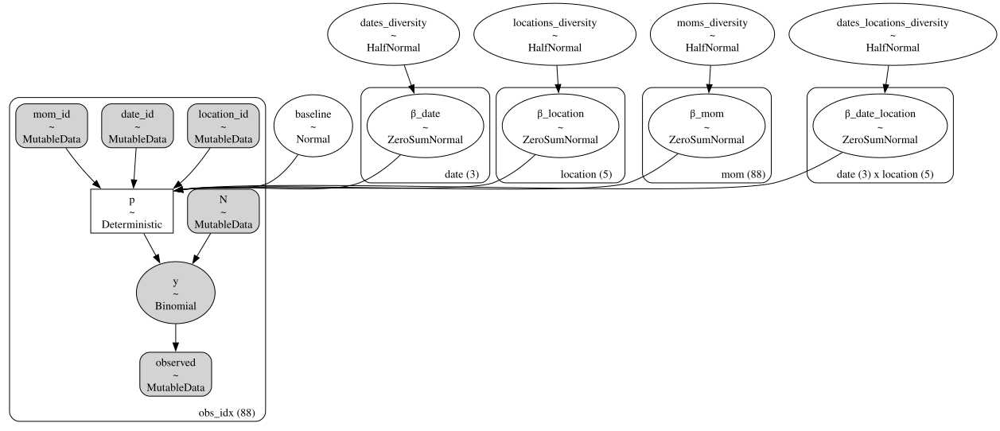

In [9]:
pm.model_to_graphviz(gh_pymc_centered_model)

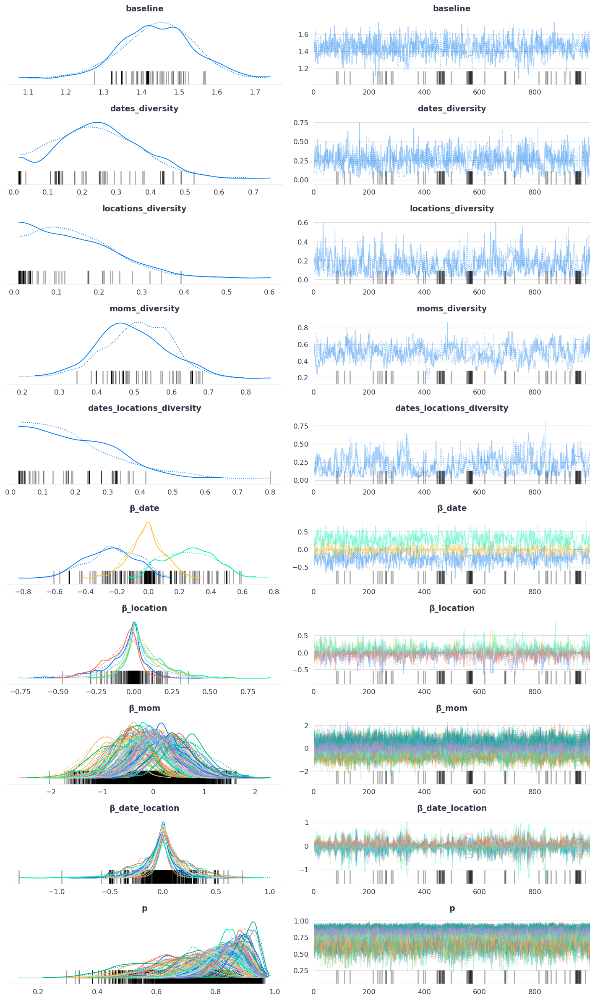

In [10]:
az.plot_trace(idata_gh_pymc_centered)
plt.tight_layout()
plt.show()

In [11]:
# Create the full set of (date, location) pairs using a Cartesian product
all_pairs = (
    pd.DataFrame(product(dates, locations), columns=["date", "location"])
#         .set_index(["date", "location"])
)

# Merge the original DataFrame with the full set of pairs
# This will result in NaNs where the (date, location) pair did not originally exist
(
    all_pairs.merge(df_grasshopper.groupby(["date", "location"]).size().rename("size"),
                    on=["date", "location"], how="left")
    .fillna(0)
    .astype(int)
)

,date,location,size
0,1,1,2
1,1,2,6
2,1,3,4
3,1,4,0
4,1,5,8
5,2,1,12
6,2,2,0
7,2,3,10
8,2,4,0
9,2,5,19


#### Notes:
* there are many divergences, because there are combinations where there are no/few datapoints, which makes it
hard for the centered reparameterization to converge
* solutions:
    * increase acceptance rate- smaller step size should make less divergences (but is slower)
    * try **non-centered reparameterization**

### Increasing acceptance rate
* if a model is very badly parametrize, increasing target_accept won't do any magic

In [11]:
with gh_pymc_centered_model:
    idata_gh_pymc_centered2 = pm.sample(random_seed=rng, target_accept=0.99)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline, dates_diversity, locations_diversity, moms_diversity, dates_locations_diversity, β_date, β_location, β_mom, β_date_location]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 196 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


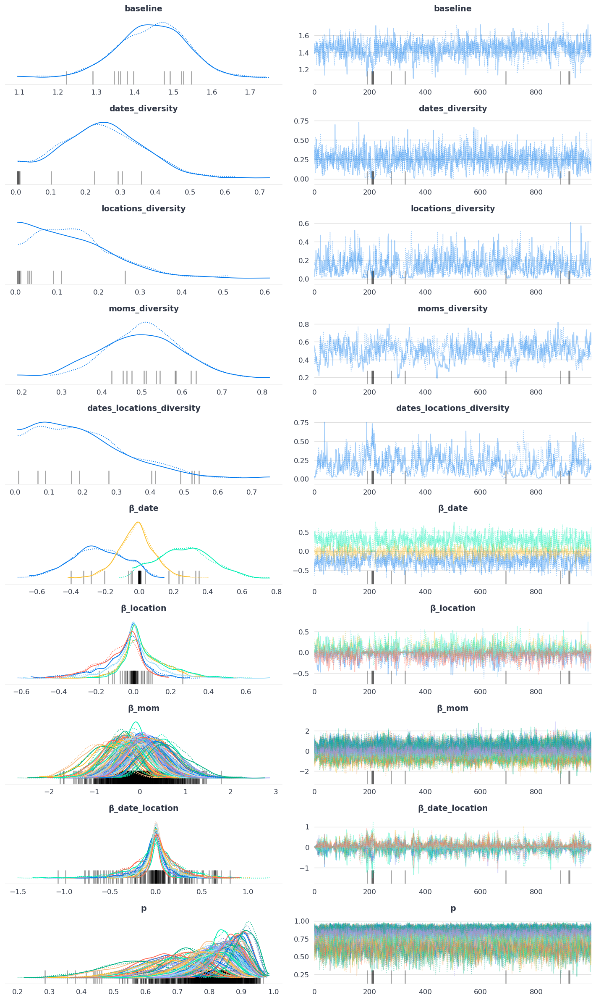

In [12]:
az.plot_trace(idata_gh_pymc_centered2)
plt.tight_layout()
plt.show()

### Bambi

In [13]:
priors = {
    "common": bmb.Prior("Normal", mu=0, sigma=1),  # global effect priors
    # group-specific effect priors
    "group_specific": bmb.Prior(
        "Normal", mu=0, sigma=bmb.Prior("Gamma", alpha=2, beta=2)
    )
}
gh_bmb_centered_model = bmb.Model(
    formula="p(y, n) ~ 1 + (1 | mom) + (1 | date) + (1 | location) + (1 | date:location)",
    data=df_grasshopper,
    family="binomial",
    categorical=["date", "location", "mom"],
    priors=priors,
    noncentered=False
)
gh_bmb_centered_model.build()
gh_bmb_centered_model

/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/formulae/terms/variable.py:87: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  elif is_string_dtype(x) or is_categorical_dtype(x):
/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/formulae/terms/call.py:108: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  elif is_string_dtype(x) or is_categorical_dtype(x) or isinstance(x, CategoricalBox):


       Formula: p(y, n) ~ 1 + (1 | mom) + (1 | date) + (1 | location) + (1 | date:location)
        Family: binomial
          Link: p = logit
  Observations: 88
        Priors: 
    target = p
        Common-level effects
            Intercept ~ Normal(mu: 0.0, sigma: 1.0)
        
        Group-level effects
            1|mom ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))
            1|date ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))
            1|location ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))
            1|date:location ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))

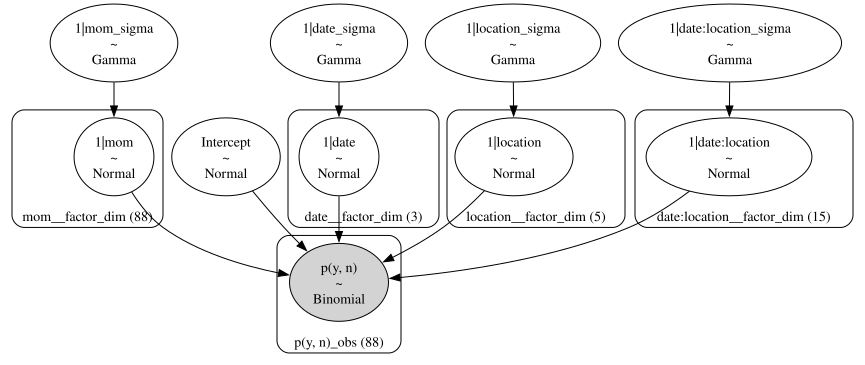

In [14]:
gh_bmb_centered_model.graph()

In [15]:
idata_gh_bmb_centered = gh_bmb_centered_model.fit(
    random_seed=rng, idata_kwargs={"log_likelihood": True}
)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [Intercept, 1|mom_sigma, 1|mom, 1|date_sigma, 1|date, 1|location_sigma, 1|location, 1|date:location_sigma, 1|date:location]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 37 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


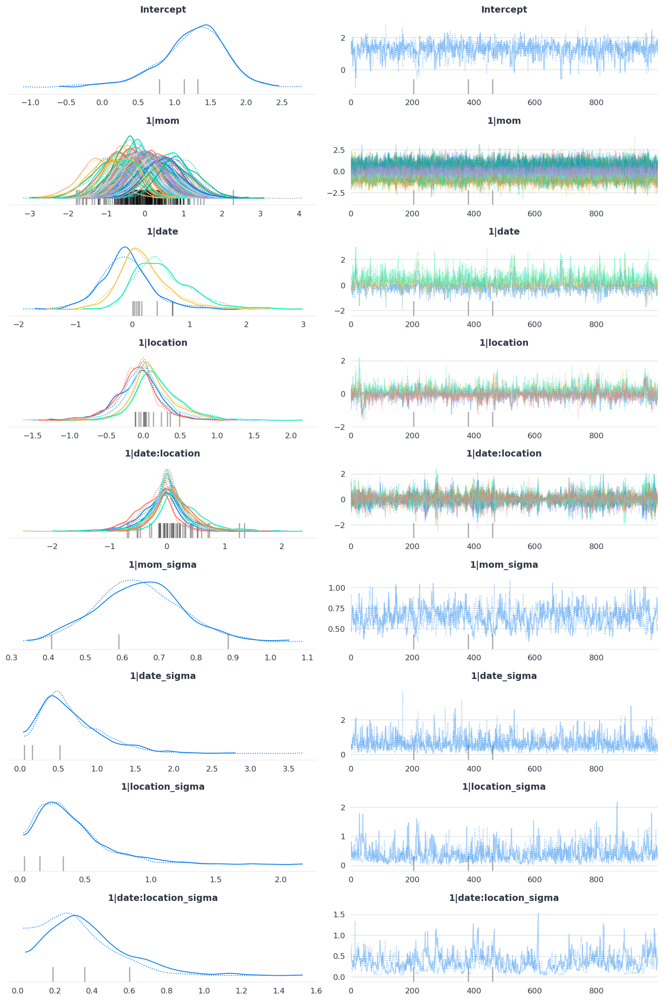

In [16]:
az.plot_trace(idata_gh_bmb_centered)
plt.tight_layout()
plt.show()

## Non-centered models
$ \beta \sim N(\mu, \sigma) = \mu + z \cdot \sigma $, where $z \sim N(0, 1)$ is independent noise
* decorrelate the parameters from the sampling process (the parameters are fixed (deterministic))
* Models the relative deviations of those parameters from the latent population
* $\begin{align*} \beta_{\text{cat}} &\sim \text{ZeroSumNormal}(\sigma=\sigma_{\text{diversity}}) \\
&= \underbrace{\text{ZeroSumNormal}(\sigma=1)}_{\text{raw}} \cdot \underbrace{\sigma_{\text{diversity}}}_{\text{scale}} \end{align*}$


### PyMC

In [8]:
def create_nc_cat_zsn_comp(
    name: str, dims: str | Tuple[str, ...], sigma: float=0.2
) -> tuple[pt.TensorVariable, pt.TensorVariable]:
    """Helper function for creating non-centered ZeroSumNormal components (i.e., raw and scale)"""
    # raw- average behavior (individual level)
    raw = (
        pm.ZeroSumNormal(f"{name}_raw", dims=dims) if isinstance(dims, str) else
        pm.ZeroSumNormal(f"{name}_raw", dims=dims, zerosum_axes=len(dims))
    )
    # scale- diversity parameter (group-level, i.e., shared across the group)
    scale = pm.HalfNormal(f"{name.split('β_')[1]}_diversity", sigma=sigma)
    return raw, scale
#     return pm.Deterministic(name, raw * scale, dims=dims)

In [18]:
with pm.Model(
    coords=GRASSHOPPER_COORDS["immutable"], coords_mutable=GRASSHOPPER_COORDS["mutable"], check_bounds=False
) as gh_pymc_noncentered_model:
    
    ########### DATA COMPONENTS ########
    date_id = pm.MutableData("date_id", date_idx, dims="obs_idx")
    location_id = pm.MutableData("location_id", location_idx, dims="obs_idx")
    mom_id = pm.MutableData("mom_id", mom_idx, dims="obs_idx")
    N = pm.MutableData("N", df_grasshopper["n"], dims="obs_idx")
    observed = pm.MutableData("observed", df_grasshopper["y"], dims="obs_idx")
    ########### DATA COMPONENTS ########
    
    ##### COMMON EFFECT #####
    baseline = pm.Normal("baseline", mu=0, sigma=0.5)
    ##### COMMON EFFECT #####
    
    β_date_raw, β_date_scale = create_nc_cat_zsn_comp("β_date", dims="date")
    β_date = pm.Deterministic("β_date", β_date_raw * β_date_scale, dims="date")
    β_location_raw, β_location_scale = create_nc_cat_zsn_comp("β_location", dims="location")
    β_location = pm.Deterministic("β_location", β_location_raw * β_location_scale, dims="location")
    β_mom_raw, β_mom_scale = create_nc_cat_zsn_comp("β_mom", dims="mom")
    β_mom = pm.Deterministic("β_mom", β_mom_raw * β_mom_scale, dims="mom")
    β_date_location_raw, β_date_location_scale = create_nc_cat_zsn_comp(
        "β_date_location", dims=("date", "location")
    )
    β_date_location = pm.Deterministic(
        "β_date_location", β_date_location_raw * β_date_location_scale, dims=("date", "location"))
    
    η = (
        baseline + 
        β_date[date_id] + 
        β_location[location_id] +
        β_date_location[date_id, location_id] + 
        β_mom[mom_id]
    )
    p_bin = pm.Deterministic("p", pm.math.sigmoid(η), dims="obs_idx")
    # likelihood
    _ = pm.Binomial("y", n=N, p=p_bin, observed=observed, dims="obs_idx")
    
    idata_gh_pymc_noncentered = pm.sample(random_seed=rng)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline, β_date_raw, date_diversity, β_location_raw, location_diversity, β_mom_raw, mom_diversity, β_date_location_raw, date_location_diversity]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 30 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


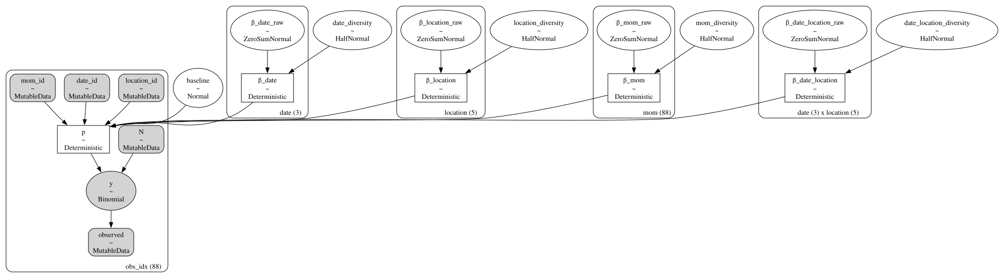

In [19]:
pm.model_to_graphviz(gh_pymc_noncentered_model)

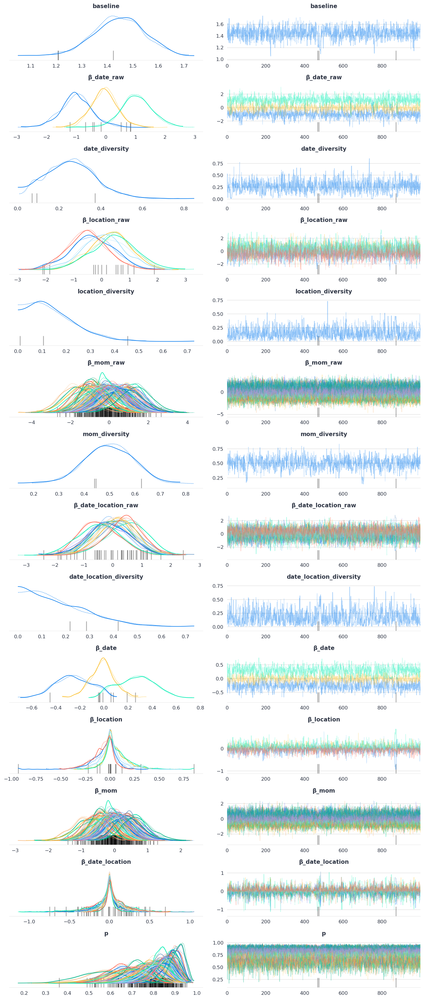

In [20]:
az.plot_trace(idata_gh_pymc_noncentered)
plt.tight_layout()
plt.show()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline, β_date_raw, date_diversity, β_location_raw, location_diversity, β_mom_raw, mom_diversity, β_date_location_raw, date_location_diversity]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 31 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


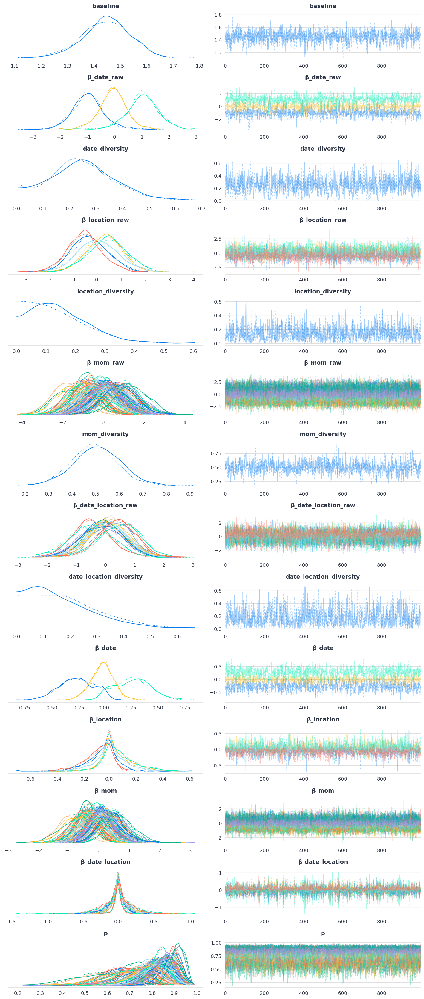

In [21]:
with gh_pymc_noncentered_model:
    idata_gh_pymc_noncentered2 = pm.sample(random_seed=rng, target_accept=0.85)

az.plot_trace(idata_gh_pymc_noncentered2)
plt.tight_layout()
plt.show()

#### Notes
* using non-centered model we get just few divergences, and when we increase target_accept, we get no divergences

### Bambi

In [22]:
gh_bmb_noncentered_model = bmb.Model(
    formula="p(y, n) ~ 1 + (1 | mom) + (1 | date) + (1 | location) + (1 | date:location)",
    data=df_grasshopper,
    family="binomial",
    categorical=["date", "location", "mom"],
    priors=priors,
    noncentered=True
)
gh_bmb_noncentered_model.build()
gh_bmb_noncentered_model

/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/formulae/terms/variable.py:87: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  elif is_string_dtype(x) or is_categorical_dtype(x):
/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/formulae/terms/call.py:108: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  elif is_string_dtype(x) or is_categorical_dtype(x) or isinstance(x, CategoricalBox):


       Formula: p(y, n) ~ 1 + (1 | mom) + (1 | date) + (1 | location) + (1 | date:location)
        Family: binomial
          Link: p = logit
  Observations: 88
        Priors: 
    target = p
        Common-level effects
            Intercept ~ Normal(mu: 0.0, sigma: 1.0)
        
        Group-level effects
            1|mom ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))
            1|date ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))
            1|location ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))
            1|date:location ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))

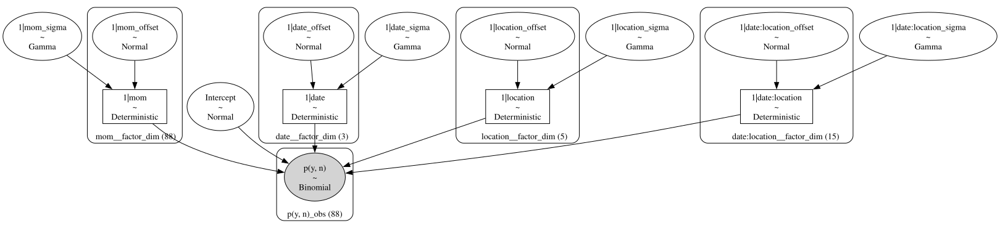

In [23]:
gh_bmb_noncentered_model.graph()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [Intercept, 1|mom_sigma, 1|mom_offset, 1|date_sigma, 1|date_offset, 1|location_sigma, 1|location_offset, 1|date:location_sigma, 1|date:location_offset]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 72 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


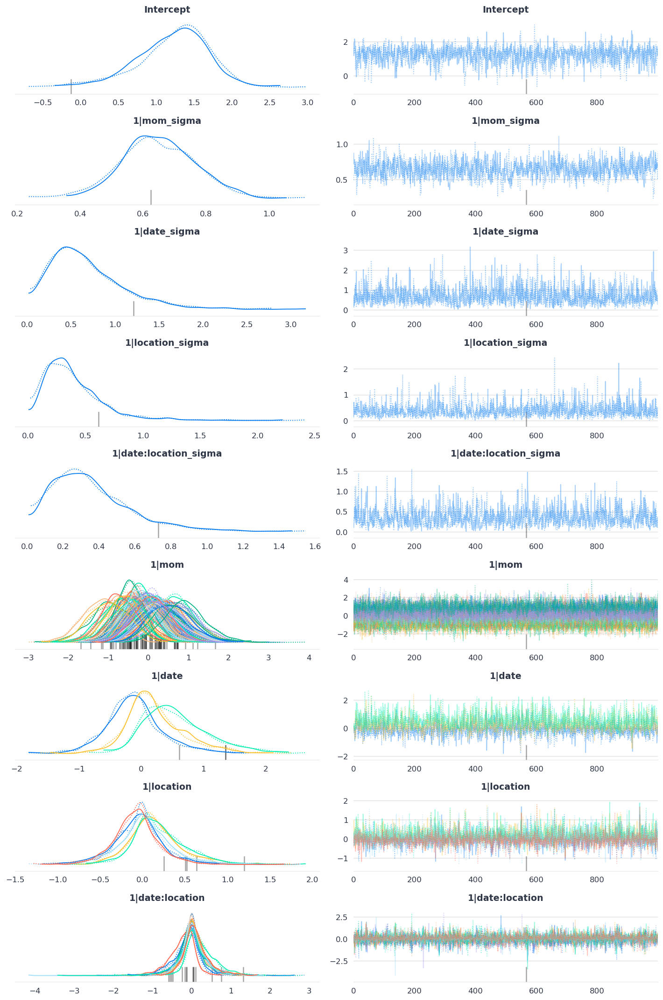

In [24]:
idata_gh_bmb_noncentered = gh_bmb_noncentered_model.fit(
    random_seed=rng, idata_kwargs={"log_likelihood": True}, target_accept=0.95
)

az.plot_trace(idata_gh_bmb_noncentered)
plt.tight_layout()
plt.show()

## Only interaction (with no main effects)
* **Interaction with no main effects**- we don’t model $x_1, x_2$, only $x_1 \cdot x_2$
1. Apply `ZeroSumNormal` on both axes $(d_1 \cdot d_2, c)$, where $d_1 \cdot d_2$ is the interaction dimension (we don’t add an offset)
1. Reshape to the original shape $(d_1 , d_2, c)$


### PyMC

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline, β_date_location_diversity, β_mom_raw, mom_diversity, β_date_location_raw]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


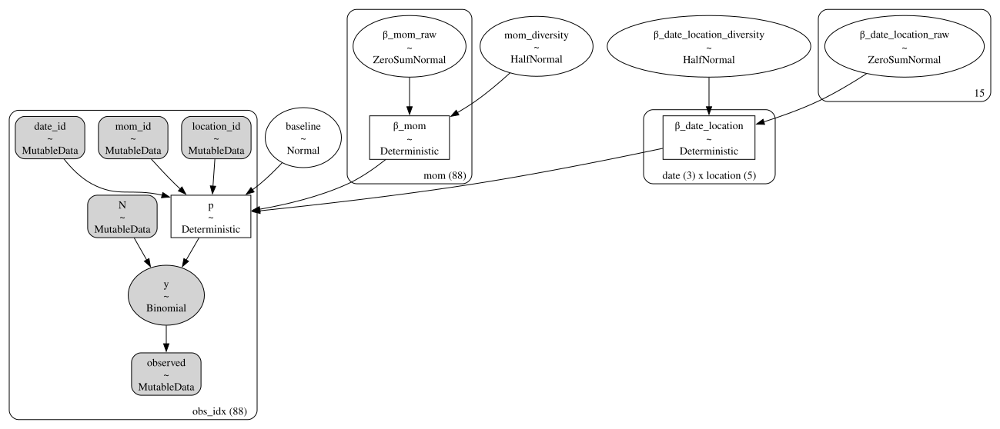

In [20]:
with pm.Model(
    coords=GRASSHOPPER_COORDS["immutable"], coords_mutable=GRASSHOPPER_COORDS["mutable"], check_bounds=False
) as gh_pymc_noncentered_interact_model:
    
    ########### DATA COMPONENTS ########
    date_id = pm.MutableData("date_id", date_idx, dims="obs_idx")
    location_id = pm.MutableData("location_id", location_idx, dims="obs_idx")
    mom_id = pm.MutableData("mom_id", mom_idx, dims="obs_idx")
    N = pm.MutableData("N", df_grasshopper["n"], dims="obs_idx")
    observed = pm.MutableData("observed", df_grasshopper["y"], dims="obs_idx")
    ########### DATA COMPONENTS ########
    
    ##### COMMON EFFECT #####
    baseline = pm.Normal("baseline", mu=0, sigma=0.5)
    ##### COMMON EFFECT #####
    
    #### SHRINKAGE PARAMETER ####
    β_date_location_scale = pm.HalfNormal("β_date_location_diversity", sigma=0.2)
    #### SHRINKAGE PARAMETER ####
    
    β_mom_raw, β_mom_scale = create_nc_cat_zsn_comp("β_mom", dims="mom")
    β_mom = pm.Deterministic("β_mom", β_mom_raw * β_mom_scale, dims="mom")
    #### interaction with no main effects ####
    β_date_location_raw = (
        pm.ZeroSumNormal("β_date_location_raw", shape=(n_dates * n_locations,))
        .reshape((n_dates, n_locations))
    )
    β_date_location = pm.Deterministic(
        "β_date_location", β_date_location_raw * β_date_location_scale, dims=("date", "location")
    )
    
    η = baseline + β_date_location[date_id, location_id] + β_mom[mom_id]
    p_bin = pm.Deterministic("p", pm.math.sigmoid(η), dims="obs_idx")
    # likelihood
    _ = pm.Binomial("y", n=N, p=p_bin, observed=observed, dims="obs_idx")
    
    idata_gh_pymc_noncentered_interact = pm.sample(random_seed=rng)
    
pm.model_to_graphviz(gh_pymc_noncentered_interact_model)

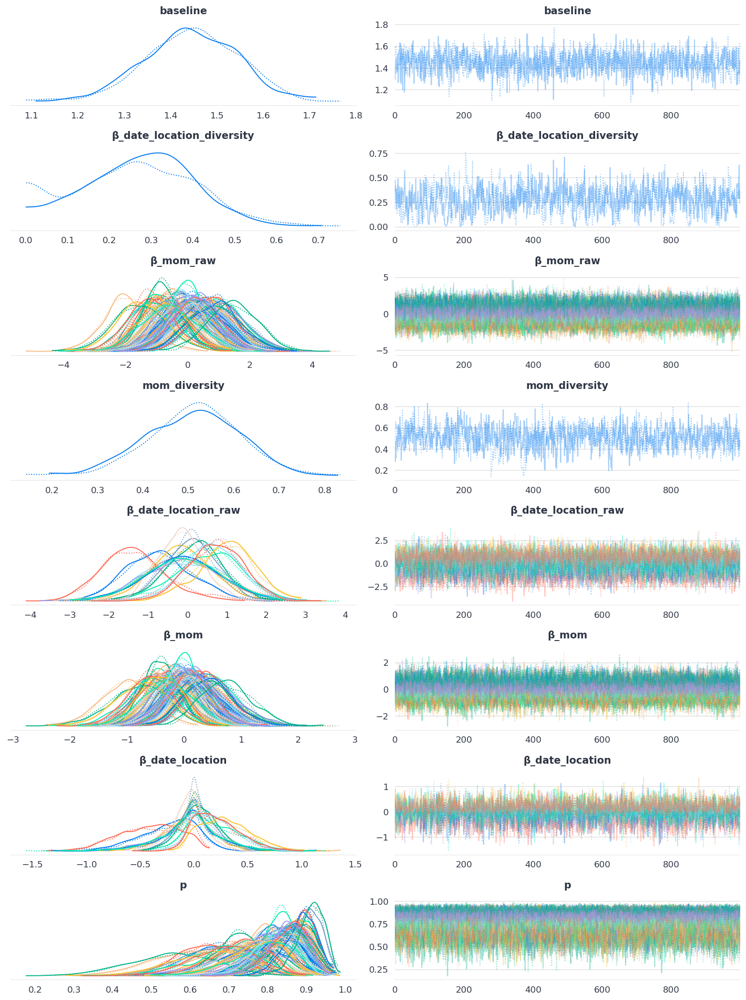

In [21]:
az.plot_trace(idata_gh_pymc_noncentered_interact)
plt.tight_layout()
plt.show()

### Bambi

In [27]:
gh_bmb_noncentered_interact_model = bmb.Model(
    formula="p(y, n) ~ 1 + (1|mom) + (1|date:location)",
    data=df_grasshopper,
    family="binomial",
    categorical=["date", "location", "mom"],
    priors=priors,
    noncentered=True
)
gh_bmb_noncentered_interact_model.build()
gh_bmb_noncentered_interact_model

/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/formulae/terms/variable.py:87: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  elif is_string_dtype(x) or is_categorical_dtype(x):
/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/formulae/terms/call.py:108: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  elif is_string_dtype(x) or is_categorical_dtype(x) or isinstance(x, CategoricalBox):


       Formula: p(y, n) ~ 1 + (1|mom) + (1|date:location)
        Family: binomial
          Link: p = logit
  Observations: 88
        Priors: 
    target = p
        Common-level effects
            Intercept ~ Normal(mu: 0.0, sigma: 1.0)
        
        Group-level effects
            1|mom ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))
            1|date:location ~ Normal(mu: 0.0, sigma: Gamma(alpha: 2.0, beta: 2.0))

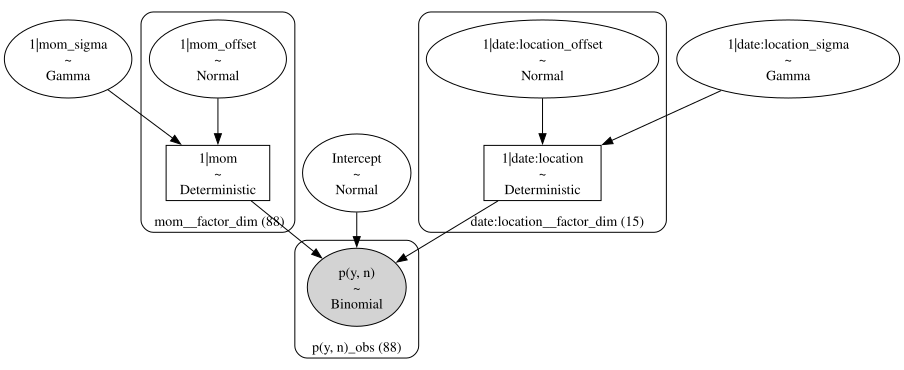

In [28]:
gh_bmb_noncentered_interact_model.graph()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [Intercept, 1|mom_sigma, 1|mom_offset, 1|date:location_sigma, 1|date:location_offset]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


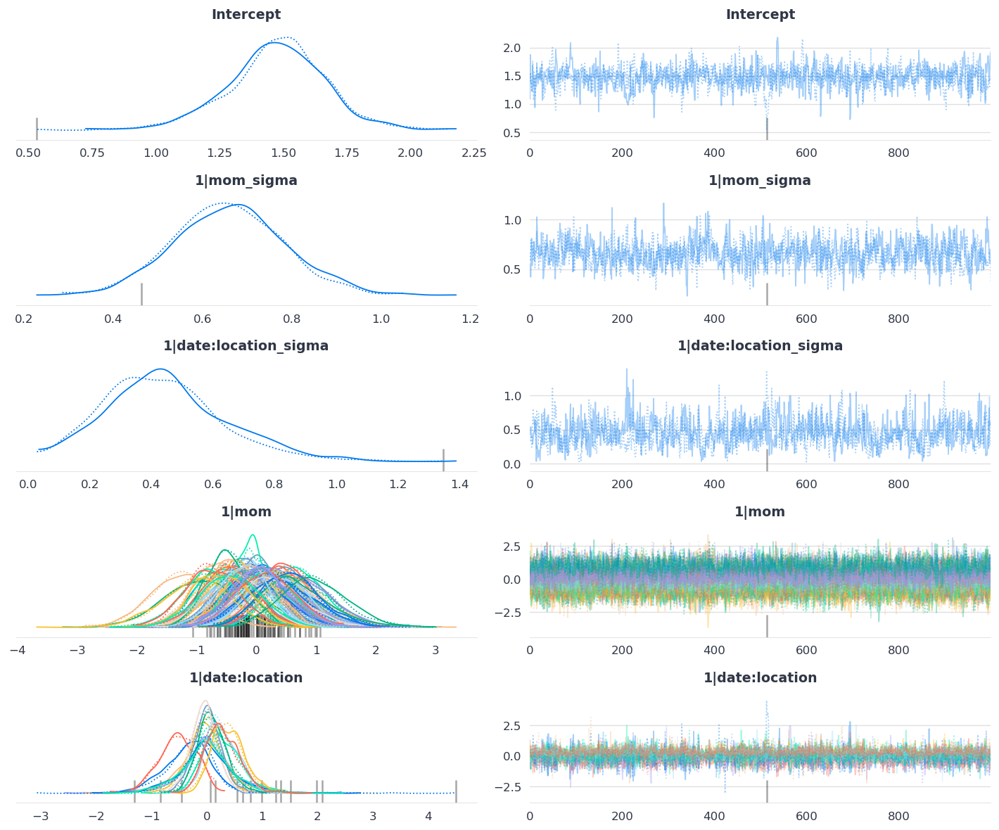

In [29]:
idata_gh_bmb_noncentered_interact = gh_bmb_noncentered_interact_model.fit(
    random_seed=rng, idata_kwargs={"log_likelihood": True}
)

az.plot_trace(idata_gh_bmb_noncentered_interact)
plt.tight_layout()
plt.show()

### Notes
* interaction only (non-centered), results in best performance (no divergences)

### Foreset Plot
* 4-panel forest plot, showing the probability of having the chromosome for each mom's descendants.
* we get a different prediction for each observation

In [22]:
with gh_pymc_noncentered_interact_model:
    idata_gh_pymc_noncentered_interact.extend(
        pm.sample_posterior_predictive(
            idata_gh_pymc_noncentered_interact, random_seed=rng
        )
    )

Sampling: [y]


In [23]:
pop_mean = (
    invlogit(idata_gh_pymc_noncentered_interact.posterior["baseline"]).mean().to_numpy()
)
pop_mean

array(0.80876037)

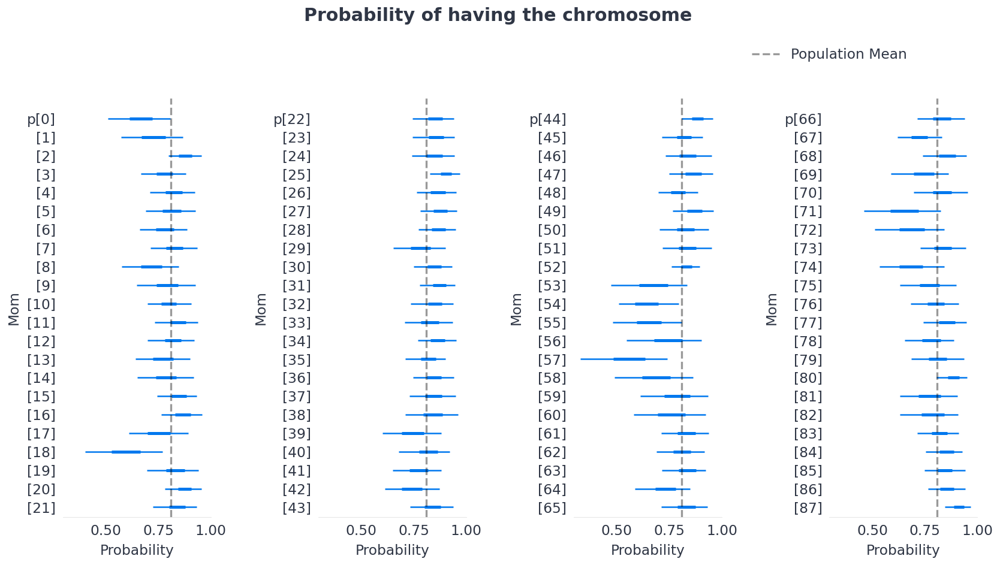

In [24]:
# σ(β_0) - population mean probability
pop_mean = (
    invlogit(idata_gh_pymc_noncentered_interact.posterior["baseline"]).mean().to_numpy()
)

# split predictions into 4 equal groups
n_cols = 4
segments = np.array_split(np.arange(len(df_grasshopper)), n_cols)

# Create subplots
fig, axes = plt.subplots(1, n_cols, sharex=True, figsize=(14, 8))

# Plot data and add the legend
for ax, segment in zip(axes.ravel(), segments):
    az.plot_forest(
        idata_gh_pymc_noncentered_interact,
        var_names="p",  # take only the "p" component
        combined=True,
        coords={"obs_idx": segment},  # forest plot slicing on obs_idx (taking only the segment part)
        ax=ax,
    )
    ax.axvline(
        pop_mean,
        label="Population Mean",
        color="k",
        ls="--",
        alpha=0.4,
        lw=2,
    )
    ax.set_title("", fontsize=0)
    ax.set_xlabel("Probability", fontsize=14)
    ax.set_ylabel("Mom", fontsize=14)
#     ax.set_yticklabels(segment[::-1])  # reverse the order

# Create a common legend below the subplots
plt.legend(
    loc="upper center",
    bbox_to_anchor=(0, 1.15),
    fancybox=True,
    shadow=True,
    fontsize=14,
)

plt.suptitle("Probability of having the chromosome")
plt.tight_layout()

## Predicting New Groups
We'll look at the three representative cases:
1. A new observation with known location, N and mom, but **new date**.
2. A new observation with known N and mom, but **new date and location**.
3. A new observation with known date, location and N, but **new mom**.

In [12]:
df_grasshopper.loc[:2, ["date", "location", "n", "mom"]]

,date,location,n,mom
0,1,1,21,0
1,1,1,12,1
2,2,1,34,2


In [13]:
# create 3 new observations 
df_grasshopper["mom"] = df_grasshopper.index
new_data = df_grasshopper.loc[:2, ["date", "location", "n", "mom"]].copy()

# observation i- new date with random (but known) location, n and mom
new_data.loc[0] = [
    df_grasshopper.date.max() + 1,
    np.random.choice(df_grasshopper.location),
    np.random.choice(df_grasshopper.n),
    np.random.choice(df_grasshopper.mom),
]

# observation ii- new date and new location with random (but known) n and mom
new_data.loc[1] = [
    df_grasshopper.date.max() + 2,
    df_grasshopper.location.max() + 1,
    np.random.choice(df_grasshopper.n),
    np.random.choice(df_grasshopper.mom),
]

# # observation iii- new mom with random (but known) date, location and n
new_data.loc[2] = [
    np.random.choice(df_grasshopper.date),
    np.random.choice(df_grasshopper.location),
    np.random.choice(df_grasshopper.n),
    df_grasshopper.mom.max() + 1,
]
new_data

,date,location,n,mom
0,4,1,13,17
1,5,6,9,61
2,3,2,26,88


### Out-Of-Sample Indexing
* `pd.Categorical(values, categories=categories).codes`
    * a value that is not in the categories set, is set to -1
    * -1,000 - mark as a novelty (new value that was not seen in training)

In [14]:
# add indexing for inference
new_data["date_idx"] = pd.Categorical(new_data.date, categories=dates).codes
new_data["location_idx"] = pd.Categorical(new_data.location, categories=locations).codes
new_data["mom_idx"] = pd.Categorical(new_data.mom, categories=GRASSHOPPER_COORDS["immutable"]["mom"]).codes
new_data = new_data.replace({-1: -1_000})
new_data

,date,location,n,mom,date_idx,location_idx,mom_idx
0,4,1,13,17,-1000,0,17
1,5,6,9,61,-1000,-1000,61
2,3,2,26,88,2,1,-1000


In [30]:
# # declare the Multiindex as coordinates
# multi_idx_coords = xr.Coordinates.from_pandas_multiindex(
#     df_grasshopper.set_index(["date", "location"]).index, "obs_idx"
# )

# # pass it as coordinates
# idata_pymc_noncentered_interact_gh.posterior_predictive = (
#     idata_pymc_noncentered_interact_gh.posterior_predictive
#     .assign_coords(multi_idx_coords)
# )

### Sampling new group predictions
* take most similar groups, and sample prediction in proportion to group size

In [25]:
with gh_pymc_noncentered_interact_model:
    β_mom_new = pm.math.stack(
        [
            β_mom[new_data.loc[0, "mom_idx"]],  # existing mom
            β_mom[new_data.loc[1, "mom_idx"]],  # existing mom
            pt.random.choice(β_mom),  # sample mom to represent the new mom
        ]
    )

    β_date_location_new = pm.math.stack(
        [
            β_date_location[
                pt.random.choice(n_dates), new_data.loc[0, "location_idx"]
            ],  # new date, existing location
            β_date_location[
                pt.random.choice(n_dates), pt.random.choice(n_locations)
            ],  # new date, new location
            β_date_location[
                new_data.loc[2, "date_idx"], new_data.loc[2, "location_idx"]
            ],  # existing date, existing location
        ]
    )
    # recreate linear predictor using posterior values and apply sigmoid to get a probability representation
    p_bin_new = pm.Deterministic(
        "p_new",
        pm.math.sigmoid(
            baseline
            + β_mom_new
            + β_date_location_new
        )
    )
    # likelihood 
    pm.Binomial("y_new", p=p_bin_new, n=new_data["n"])
    # posterior predicttive (out-of-sapmle)
    pp = pm.sample_posterior_predictive(
        idata_gh_pymc_noncentered_interact, var_names=["p_new", "y_new"], random_seed=rng
    )

Sampling: [y_new]


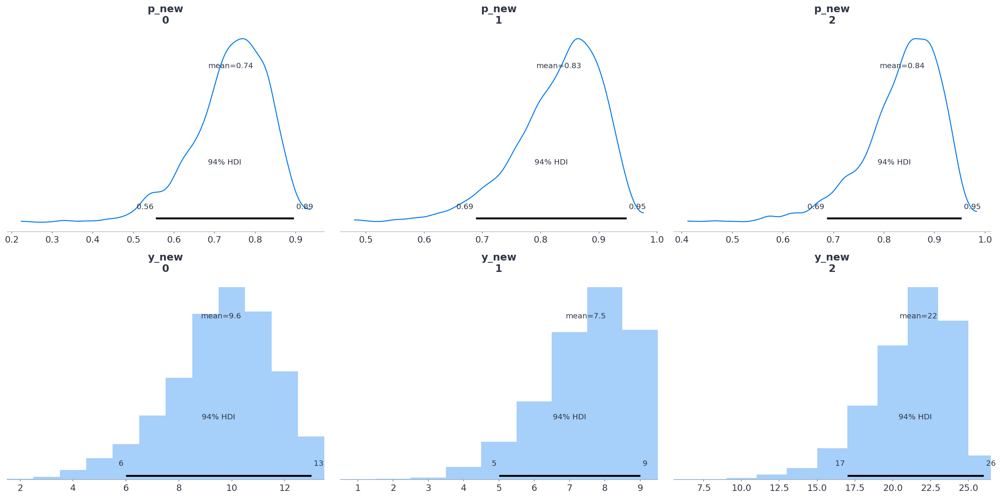

In [26]:
az.plot_posterior(pp.posterior_predictive)
plt.tight_layout()

#### Predictions with explicit priors
* Sample from (new) prior, instead of taking a random group's posterior distribution

In [27]:
with pm.Model() as m_new_obs:
    β_mom_new = pm.math.stack(
        [
            β_mom[new_data.loc[0, "mom_idx"]],  # existing mom
            β_mom[new_data.loc[1, "mom_idx"]],  # existing mom
            β_mom_scale * pm.Normal("β_mom_raw_new"),  # new mom
        ]
    )

    β_date_location_raw_new = pm.Normal(
        "β_date_location_raw_new", shape=2
    )  # 2 new (date, location) pairs
    β_date_location_new = pm.math.stack(
        [
            β_date_location_scale * β_date_location_raw_new[0],
            β_date_location_scale * β_date_location_raw_new[1],
            β_date_location[
                new_data.loc[2, "date_idx"], new_data.loc[2, "location_idx"]
            ],  # existing date, existing location
        ]
    )

    p_bin_new = pm.Deterministic(
        "p_new",
        pm.math.sigmoid(
            baseline + β_mom_new + β_date_location_new
        ),
    )

    pm.Binomial("y_new", p=p_bin_new, n=new_data["n"])

    pp = pm.sample_posterior_predictive(
        idata_gh_pymc_noncentered_interact, var_names=["p_new", "y_new"], random_seed=rng
    )

Sampling: [y_new, β_date_location_raw_new, β_mom_raw_new]


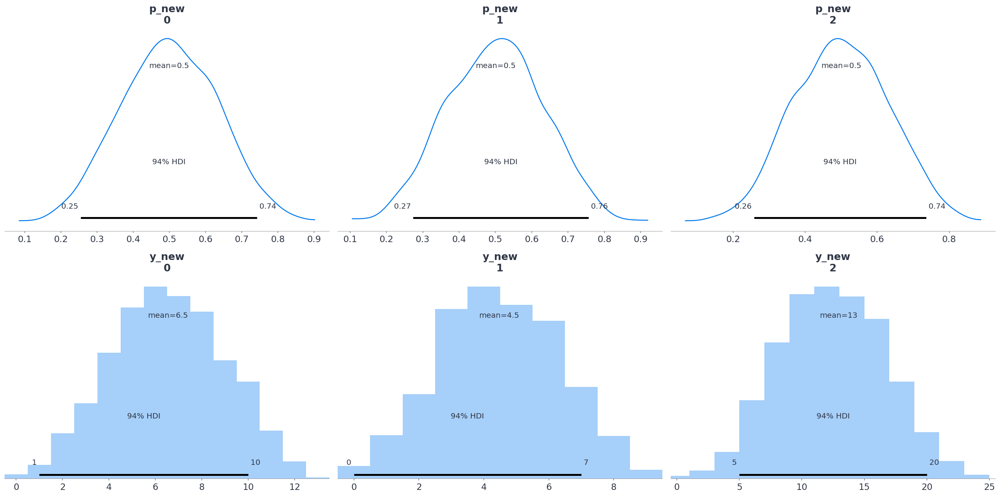

In [28]:
az.plot_posterior(pp.posterior_predictive)
plt.tight_layout()

# Eight-School Problem
* Using a 8-school model to predict two new schools

In [3]:
y = np.array([28, 8, -3, 7, -1, 1, 18, 12])
sigma = np.array([15, 10, 16, 11, 9, 11, 10, 18])

In [31]:
df_schools = pd.DataFrame(
    data=np.concatenate([y[..., None], sigma[..., None]], axis=1),
    columns=["school", "sigma"]
)
df_schools.head()

,school,sigma
0,28,15
1,8,10
2,-3,16
3,7,11
4,-1,9


In [32]:
df_schools.agg(["mean", "std"]).T

,mean,std
school,8.75,10.443727
sigma,12.50,3.338092


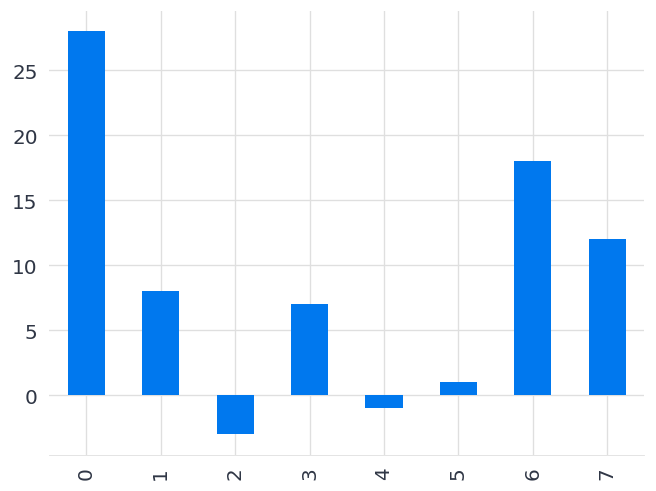

In [33]:
df_schools["school"].plot(kind="bar")
plt.show()

### Hierarchical Model

* Fit a hierarchical model that allows for a random effect that partially pools the schoolS

In [34]:
n_schools = len(df_schools)
n_schools

8

In [48]:
with pm.Model() as eight_schools:
    # Hierarchical mean and SD
    baseline = pm.Normal("baseline", mu=0, sigma=10)
    
    β_school_raw = pm.ZeroSumNormal("β_school_raw", shape=n_schools)
    β_school_scale = pm.Gamma("β_school_diversity", alpha=2, beta=2)

    # Non-centered parameterization of random effect
    μ = pm.Deterministic("μ", baseline + β_school_raw * β_school_scale)
    
    # normal likelihood with known SD
    pm.Normal("school", μ, sigma=df_schools["sigma"].to_numpy(), observed=df_schools["school"].to_numpy())

    idata_eight = pm.sample(random_seed=rng)
    idata_eight.extend(pm.sample_posterior_predictive(idata_eight, random_seed=rng))

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline, β_school_raw, β_school_diversity]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 5 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics
Sampling: [school]


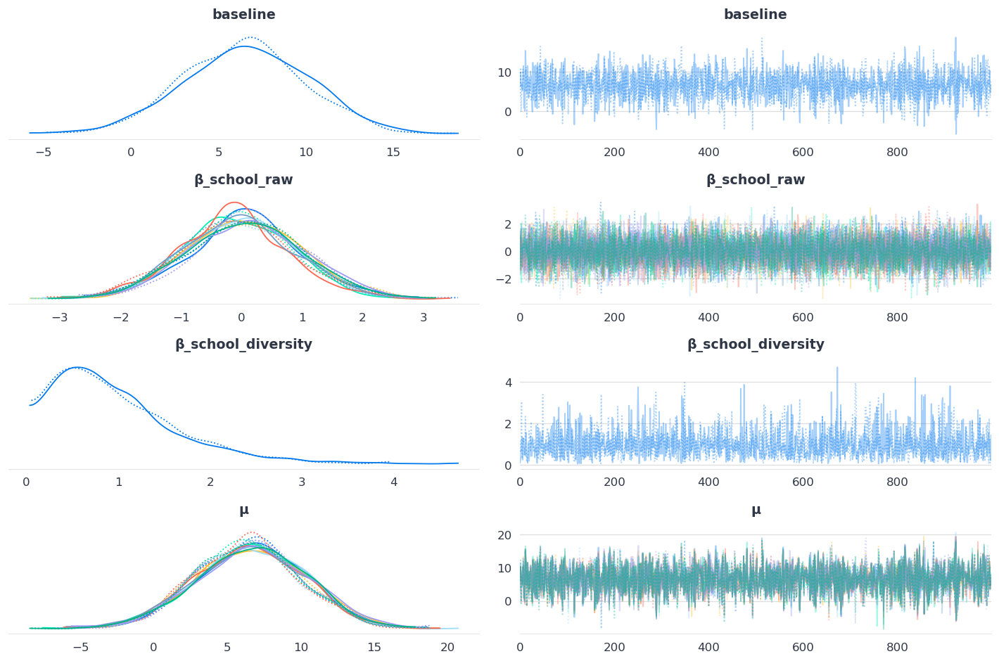

In [49]:
az.plot_trace(idata_eight)
plt.tight_layout()
plt.show()

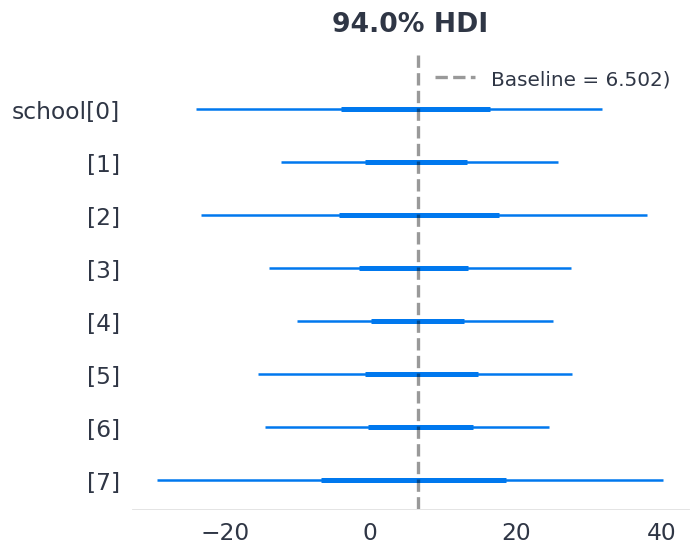

In [50]:
ax = az.plot_forest(
        idata_eight.posterior_predictive,
        combined=True,

    )[0]

ax.axvline(
    x=idata_eight.posterior.baseline.mean(),
    color="k",
    alpha=0.4,
    ls="--",
    lw=2,
    label=f"Baseline = {idata_eight.posterior.baseline.mean().item():.3f})",
)
ax.legend()
plt.tight_layout()
plt.show()

## New Groups Predictions
* Simulating what a 9th and 10th schools might look like, and visualize predictions
* Let's also assume we have a unique prior for each new school:
    * The 9th school is believed to have a measurement error between 10 and 20.
    * The 10th school, on the contrary, is said to have a relatively low measurement error, between 5 and 7.

In [51]:
n_new_obs = 2

In [52]:
with eight_schools:
    # get two random samples from β_school_raw
    β_school_raw_new = pm.Deterministic(
        "β_school_raw_new", pt.random.choice(β_school_raw, size=n_new_obs)
    )
    
    μ_new = pm.Deterministic("μ_new", baseline + β_school_raw_new * β_school_scale)
    # sigma priors: σ_9 ~ U[10, 20], σ_10 ~ U[5, 7]
    σ_new = pm.Uniform("σ_new", lower=[10, 5], upper=[20, 7])
    # out-of-sample likelihood
    pm.Normal("new_school", mu=μ_new, sigma=σ_new)
    # posterior predictive samples
    pp = pm.sample_posterior_predictive(idata_eight, var_names=["new_school"], random_seed=rng)

Sampling: [new_school, σ_new]


In [53]:
az.summary(pp)

/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/arviz/stats/stats.py:1351: UserWarning: Selecting first found group: posterior_predictive
  warnings.warn(f"Selecting first found group: {data.groups()[0]}")


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
new_school[0],6.428,15.772,-21.312,38.300,0.364,0.257,1882.0,1934.0,1.0
new_school[1],6.465,6.881,-5.071,20.191,0.161,0.114,1828.0,1842.0,1.0


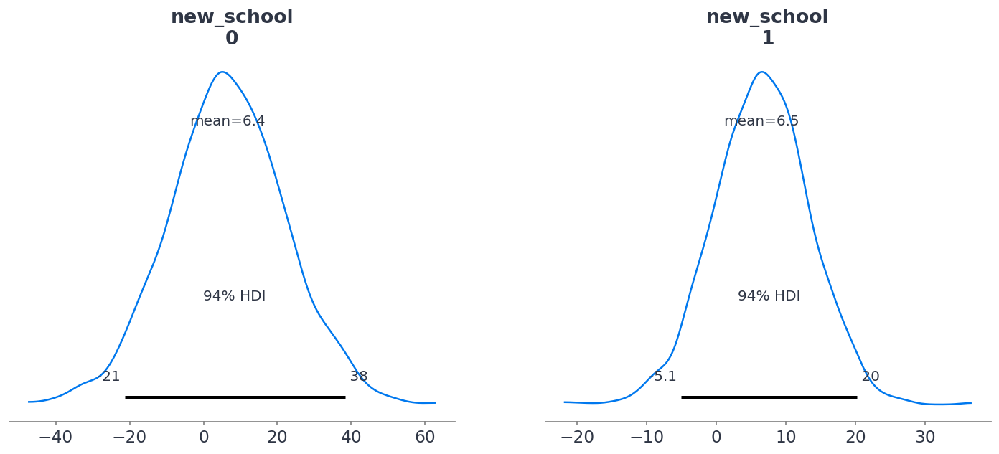

In [54]:
az.plot_posterior(pp.posterior_predictive);

## Predictions with explicit priors
* Task- make posterior predictive from "old schools" and "new schools"
* Let's also assume that the mean of school 10 is expected to be one point above the baseline.
* We don't know what the `school_raw` should be for the two unobserved schools, so we want to sample from a prior. 
    * solution- create two vectors of variables separately, `school_raw` and `school_raw_new`, and concatenate them.
        * `sample_posterior_predictive` reuses the `InferenceData` draws for `school_raw` and take new draws (from the associated prior) for `school_raw_new`.

* When we request samples for variables that depend on unobserved variables that can't be found in the `InferenceData`, we will get draws from their prior. This is how we will get `school_raw_new` draws, needed to generate predictions for our variable of interest, `school`.

In [55]:
with pm.Model() as ten_schools:
    # These are unchanged
    baseline = pm.Normal("baseline", mu=0, sigma=10)
    β_school_scale = pm.Gamma("β_school_scale", alpha=2, beta=2)
    β_school_raw = pm.ZeroSumNormal("β_school_raw", sigma=1, shape=n_schools)

    # Priors for schools 9 and 10
    # * note- the new priors break the ZSN constraint after concatentation
    β_school_raw_new = pm.Normal(
        "school_raw_new", mu=[0, 1], sigma=1
    ) 

    # concatenate the variables from the old and new groups
    μ = pm.Deterministic(
        "μ",
        baseline + β_school_scale * pm.math.concatenate([β_school_raw, β_school_raw_new]),
    )
    
    σ_new = pm.Uniform("sigma_new", lower=[10, 5], upper=[20, 7])
    pm.Normal("school", mu=μ, sigma=pm.math.concatenate([df_schools["sigma"].to_numpy(), σ_new]))
    pp_all = pm.sample_posterior_predictive(idata_eight, var_names=["school"], random_seed=rng)

Sampling: [school, school_raw_new, sigma_new, β_school_scale]


In [56]:
az.summary(pp_all)

/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/arviz/stats/stats.py:1351: UserWarning: Selecting first found group: posterior_predictive
  warnings.warn(f"Selecting first found group: {data.groups()[0]}")


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
school[0],7.293,15.719,-23.112,35.185,0.355,0.266,1965.0,1816.0,1.0
school[1],6.646,10.622,-12.008,27.069,0.234,0.166,2068.0,2068.0,1.0
school[2],6.469,16.550,-25.998,37.080,0.348,0.261,2273.0,2013.0,1.0
school[3],6.270,11.404,-14.451,28.192,0.255,0.180,1999.0,1966.0,1.0
school[4],6.520,9.993,-11.608,26.221,0.224,0.158,1997.0,1965.0,1.0
school[5],6.331,11.751,-15.638,28.305,0.275,0.194,1854.0,1722.0,1.0
school[6],6.662,10.437,-12.365,25.854,0.221,0.181,2217.0,1939.0,1.0
school[7],6.303,18.409,-26.907,40.580,0.428,0.309,1847.0,1805.0,1.0
school[8],6.056,16.358,-21.936,39.809,0.358,0.261,2079.0,2094.0,1.0
school[9],7.443,7.361,-6.211,21.253,0.154,0.119,2264.0,1885.0,1.0


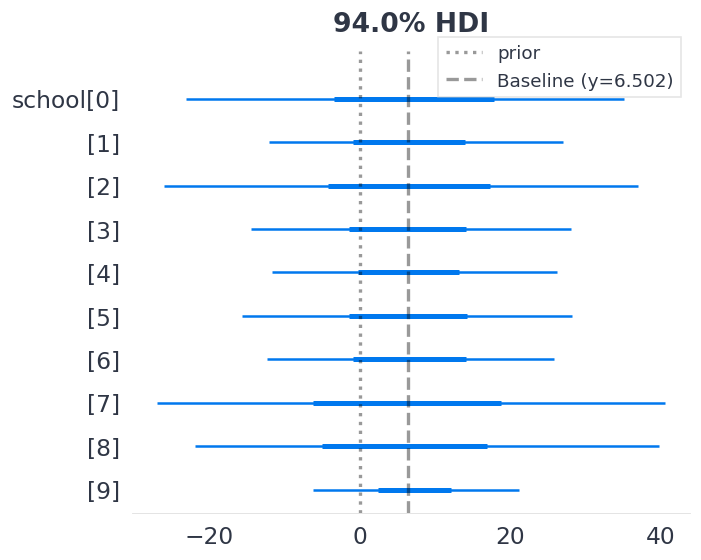

In [57]:
ax = az.plot_forest(pp_all.posterior_predictive, combined=True)[0]
ax.axvline(
    x=0,
    color="k",
    alpha=0.4,
    ls=":",
    lw=2,
    label="prior"
)
ax.axvline(
    x=idata_eight.posterior.baseline.mean(),
    color="k",
    alpha=0.4,
    ls="--",
    lw=2,
    label=f"Baseline (y={idata_eight.posterior.baseline.mean().item():.3f})",
)
ax.legend(frameon=True, bbox_to_anchor=(1, 1.05), fontsize=11);

# Estonian dataset
* For each stratum find its intentional vote
* strata- (age_group, education, gender, nationality, electoral_district, unit)
    * unit- a sub-region in the electoral_district
* 11 different parties

In [3]:
observed_aggregated_answers = pd.read_csv("../data/ee-aggregated-polls.csv")
observed_aggregated_answers.head()

,age_group,education,gender,nationality,electoral_district,unit,EKRE,Eesti 200,Hard to say,Isamaa,Keskerakond,Mitte ükski erakond,Other,Parempoolsed,Reformierakond,Rohelised,SDE,N
0,16-24,Basic education,Female,Estonian,"Haabersti, Põhja-Tallinn ja Kristiine",Haabersti,0,1,0,0,0,0,0,0,1,0,0,2
1,16-24,Basic education,Female,Estonian,"Haabersti, Põhja-Tallinn ja Kristiine",Kristiine,0,4,0,0,0,0,0,0,0,0,1,5
2,16-24,Basic education,Female,Estonian,Harju- ja Raplamaa,Harjumaa,1,0,2,0,0,0,0,0,0,0,1,4
3,16-24,Basic education,Female,Estonian,"Hiiu-, Lääne- ja Saaremaa",Hiiumaa,0,0,1,0,0,0,0,0,0,0,0,1
4,16-24,Basic education,Female,Estonian,"Hiiu-, Lääne- ja Saaremaa",Läänemaa,0,0,0,0,0,0,0,0,1,0,0,1


In [4]:
demographics_order = [
    "age_group",
    "education",
    "gender",
    "nationality",
    "electoral_district",
    "unit",
]

In [5]:
# socio-demographic components (horizontal hierarchy)
age_group_idx, age_groups = pd.factorize(observed_aggregated_answers["age_group"], sort=True)
gender_idx, genders = pd.factorize(observed_aggregated_answers["gender"], sort=True)
education_idx, educations = pd.factorize(observed_aggregated_answers["education"], sort=True)
nationality_idx, nationalities = pd.factorize(observed_aggregated_answers["nationality"], sort=True)
# region components (nested hierarchy)
# * map unit to corresponding electoral district
electoral_districts_idx, electoral_districts = (
    observed_aggregated_answers.groupby(["electoral_district", "unit"], observed=True)
    .size()
    .reset_index()["electoral_district"]
    .factorize(sort=True)
)
unit_idx, units = observed_aggregated_answers["unit"].factorize(sort=True)

In [6]:
AGG_ANS_NAIVE_COORDS = {
    "immutable": {
        "age_group": age_groups,
        "gender": genders,
        "education": educations,
        "nationality": nationalities,
        "electoral_district": electoral_districts,
        "unit": units,
        "party": observed_aggregated_answers.set_index(demographics_order + ["N"]).columns
    },
    "mutable": {
        "obs_idx": observed_aggregated_answers.index
    }
}

n_party = len(AGG_ANS_NAIVE_COORDS["immutable"]["party"])
n_gender = len(AGG_ANS_NAIVE_COORDS["immutable"]["gender"])
n_nat = len(AGG_ANS_NAIVE_COORDS["immutable"]["nationality"])
n_ed = len(AGG_ANS_NAIVE_COORDS["immutable"]["electoral_district"])

In [7]:
def hierarchical_zsn(
    name: str, dims: List[str] | str, n_zerosum_axes: int=1, sigma: float=0.5,
    regress_sigma: bool=False, class_dim: str="party"
) -> pm.Deterministic:
    """Helper function for non-centered hierarchical ZSN (horizontal)"""

    if not isinstance(dims, list):
        dims = [dims]
    dims = (*dims, class_dim)

    raw = pm.ZeroSumNormal(f"{name}_raw", dims=dims, n_zerosum_axes=n_zerosum_axes)
    scale = create_sigma(f"{name.split('β_')[1]}_diversity", sigma, regress_sigma, class_dim)
    # automatically broadcast scale to the shape of raw
    padded_scale = pt.shape_padleft(scale, n_ones=raw.ndim - 1)

    return pm.Deterministic(name, padded_scale * raw, dims=dims)


def create_sigma(
    name: str, sigma: float=0.5, regress_sigma: bool=False, class_dim: str="party"
) -> pm.Distribution:
    """Helper function to enable regression on standard deviations"""
    # softplus: log(1 + exp(log(σ_baseline) + log(σ_effect)))- wider prior (a weakly regularizing range) to model the heteroskedasticity
    if regress_sigma:
        log_sd_baseline = pm.Normal(f"{name}_baseline", mu=0, sigma=2)
        log_sd_party_effect = pm.ZeroSumNormal(
            f"{name}_party_effect", sigma=1, dims=class_dim
        )
        scale = pm.Deterministic(
            name, pm.math.log1pexp(log_sd_baseline + log_sd_party_effect), dims=class_dim
        )
    else:  # "standard" representation (HalfNormal)
        scale = pm.HalfNormal(name, sigma=sigma, dims=class_dim)

    return scale

## Hierarchical Non-centered Model
* Features:
    * __Horizontal components__: `age`, `gender` and `gender:nat`, 'education' (socio-demographic components)
    * __Nested components__: 'electoral_district`, `unit`
* __Heteroskedasticity__- the variance of the errors is not constant, but depends on the value of (some) covariates
    * Heterogeneity in the scale
    * We can use regression on SD to model the diversity parameter, because it is hard to infer
        * apply a transformation on the regression model to satisfy the positivity constraint of SD

### Common transformations (for SD):
* __Exponential function__:\
$\sigma_{\text{het}} = \exp{\Big ( \log{\big ( \sigma_{\text{het baseline}} \big )}  +  \log{\big ( \sigma_{\text{het for each class effect}} \big )} \Big )  }$
    * $\log{\big ( \sigma_{\text{het baseline}} \big )} \sim N(0, 0.2)$- model the log of the (global) average diversity as a normal distribution
    * 
$\log{ \big ( \sigma_{\text{het for each class effect}} \big ) \sim \text{ZeroSumNormal}(0.2)}$- model the log of the diversity of the average effect (for each) as a normal distribution
        * Diversity for each class and parent category value if nested component
    * Note- exponential gets really big, really fast (very non-linear)
        * __Narrow prior__
* __SoftPlus function__:\
$\sigma_{\text{het}} = \log { \bigg ( 1 +  \exp{\Big ( \log{\big ( \sigma_{\text{het baseline}} \big )}  +  \log{\big ( \sigma_{\text{het for each class effect}} \big )} \Big )  }   \bigg )}$
    * SoftPlus is a smooth approximation to the ReLU function:\
    $\text{SoftPlus}(x) = \frac{1}{\beta} \log{ \Big ( 1 + \exp{(\beta \cdot x) } } \Big )$
    * $ \log{\big ( \sigma_{\text{het baseline}} \big )} \sim N(0, 0.2)$
    * $\log{ \big ( \sigma_{\text{het for each class effect}} \big )} \sim \text{ZeroSumNormal}(0.2)$
    * linear on the positive real line $(y \approx x, \text{ where } x > 0)$
        * (Almost) no distortion
    * Allows __wider priors__, which can sometimes help inference.
        * A __weakly regularizing range__ relative to the exponential function



In [9]:
with pm.Model(
    coords=AGG_ANS_NAIVE_COORDS["immutable"], 
    coords_mutable=AGG_ANS_NAIVE_COORDS["mutable"], 
    check_bounds=False
) as agg_ans_model:
    
    #### DATA ####
    # * hierarchical horizontal  components
    age_group_id = pm.MutableData("age_group_id", age_group_idx, dims="obs_idx")
    gender_id = pm.MutableData("gender_id", gender_idx, dims="obs_idx")
    nationality_id = pm.MutableData("nationality_id", nationality_idx, dims="obs_idx")
    education_id = pm.MutableData("education_id", education_idx, dims="obs_idx")
    # * hierarchical nested components
    electoral_districts_id = pm.MutableData(
        "electoral_districts_id", electoral_districts_idx
    )
    unit_id = pm.MutableData("unit_idx", unit_idx, dims="obs_idx")
    # * likelihood model components
    N = pm.MutableData("N", observed_aggregated_answers["N"].to_numpy(), dims="obs_idx")
    observed = pm.MutableData(
        "observed",
        observed_aggregated_answers[AGG_ANS_NAIVE_COORDS["immutable"]["party"]].to_numpy(),
        dims=("obs_idx", "party"),
    )
    #### DATA ####
    
    # BASELINE- latent popularity for each party
    baseline_sd = pm.Gamma("baseline_sd", 2, 2)
    # a good weakly regularizing prior for standard deviations (better than HalfNormal(0.5))
    baseline = pm.ZeroSumNormal("baseline", sigma=baseline_sd, dims="party")

    #### HIERARCHICAL NESTED COMPONENTS ####
    # * electoral district component
    # deviation from baseline, specific to each electoral district
    # pooled across the nation
    σ_nation = create_sigma("nation_diversity", regress_sigma=True)
    β_electoral_district_raw = pm.ZeroSumNormal(
        "β_electoral_district_raw", dims=("electoral_district", "party"), n_zerosum_axes=2
    )
    β_electoral_district = pm.Deterministic(
        "β_electoral_district",
        β_electoral_district_raw * σ_nation,
        dims=("electoral_district", "party")
    )

    # unit-specific deviation from electoral district
    # pooled across electoral districts (ed)
    log_sd_ed_baseline = pm.Normal(
        "σ_electoral_district_baseline", mu=0, sigma=2,
    )
    # Sum to zero across unique *combinations* of electoral_district and party
    log_sd_ed_party_effect = (
        pm.ZeroSumNormal(
            "σ_electoral_district_party_effect", sigma=1, shape=n_ed * n_party)
        .reshape((n_ed, n_party))
    )
    # electoral district diversity (per electoral district and party)
    σ_electoral_district = pm.Deterministic(
        "σ_electoral_district",
        pm.math.log1pexp(log_sd_ed_baseline + log_sd_ed_party_effect),
        dims=("electoral_district", "party"),
    )
    
    β_unit_raw = pm.ZeroSumNormal(
        "β_unit_raw", dims=("unit", "party"), n_zerosum_axes=2
    )
    β_unit = pm.Deterministic(
        "β_unit",
        β_electoral_district[electoral_districts_id]  # electoral district effect
        + β_unit_raw * σ_electoral_district[electoral_districts_id],  # unit effect
        dims=("unit", "party"),
    )
    
    #### HIERARCHICAL HORIZONTAL (SOCIODEMOGRAPHICS) COMPONENTS ####
    β_age_group = hierarchical_zsn(
        name="β_age_group", dims="age_group", n_zerosum_axes=2, regress_sigma=True
    )
    
    β_education = hierarchical_zsn(
        name="β_education", dims="education", n_zerosum_axes=2, regress_sigma=True
    )
    
    # * interaction component- treat (gender, nationality) pair as a single component 
    β_gender_nat_raw = (
        pm.ZeroSumNormal("β_gender_nat_raw", shape=(n_gender * n_nat, n_party), n_zerosum_axes=2)
        .reshape((n_gender, n_nat, n_party))
    )
    β_gender_nat_scale = create_sigma("gender_nat_diversity", regress_sigma=True) 
    
    
    β_gender_nat =  pm.Deterministic(
        "β_gender_nat", β_gender_nat_raw * β_gender_nat_scale, dims=("gender", "nationality", "party")
    )
    
   # Regression components
    η = (
        baseline + 
        β_age_group[age_group_id] + β_education[education_id] + β_gender_nat[gender_id, nationality_id] + 
        β_unit[unit_id]
    )
    
    # make sure array of responses probs close to 1
    assert np.allclose(
        pm.math.softmax(η, axis=-1).eval().sum(-1), np.ones(age_group_id.eval().shape)
    )
    probs = pm.math.softmax(η, axis=-1)
    # Multinomial Likelihood
    _  = pm.Multinomial("y", n=N, p=probs,  observed=observed, dims=("obs_idx", "party"))

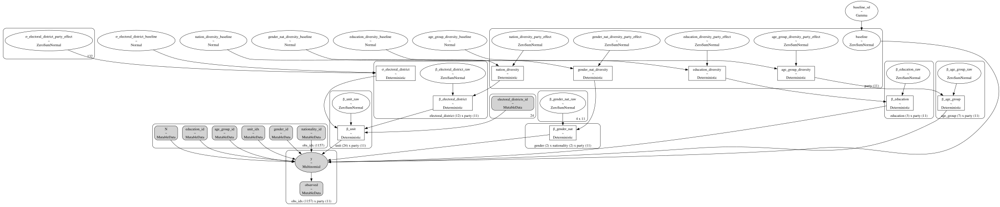

In [10]:
pm.model_to_graphviz(agg_ans_model)

In [11]:
with agg_ans_model:
    idata_agg_ans = pm.sample(random_seed=rng, target_accept=0.85)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline_sd, baseline, nation_diversity_baseline, nation_diversity_party_effect, β_electoral_district_raw, σ_electoral_district_baseline, σ_electoral_district_party_effect, β_unit_raw, β_age_group_raw, age_group_diversity_baseline, age_group_diversity_party_effect, β_education_raw, education_diversity_baseline, education_diversity_party_effect, β_gender_nat_raw, gender_nat_diversity_baseline, gender_nat_diversity_party_effect]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 822 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


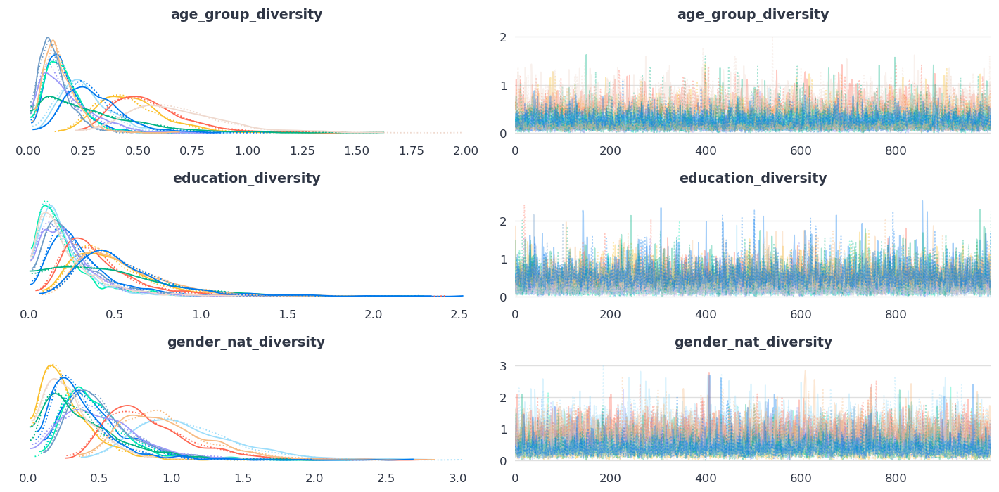

In [12]:
var_diversity = [f"{feature}_diversity" for feature in ["age_group", "education", "gender_nat"]]
az.plot_trace(idata_agg_ans, var_names=var_diversity)
plt.tight_layout()
plt.show()

<Figure size 1800x360 with 0 Axes>

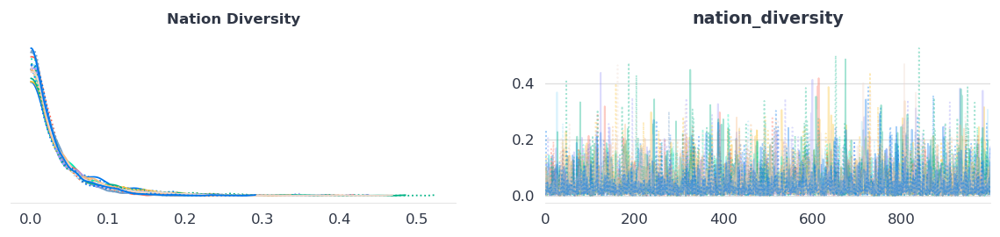

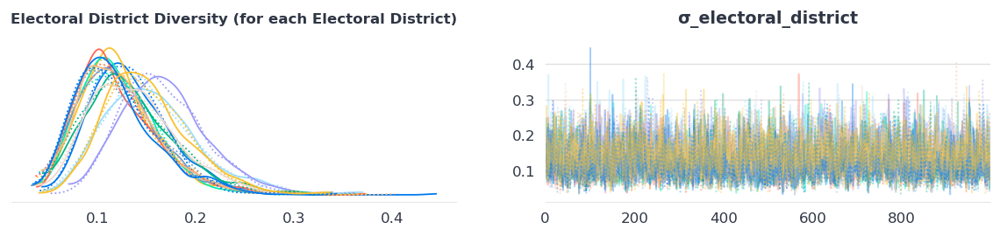

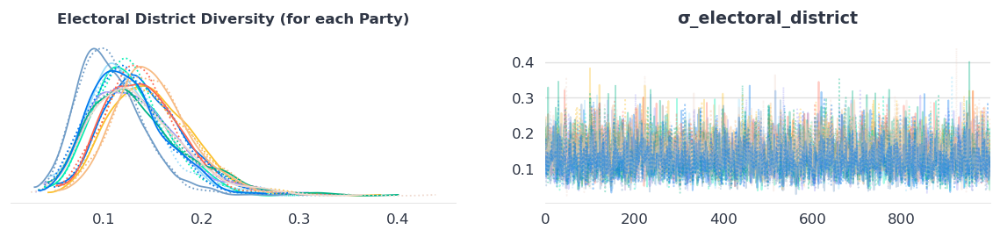

In [23]:
fig, axes = plt.subplots(3, 2, figsize=(15, 3), layout="constrained")
fig.clear()
axes[0, :] = az.plot_trace(idata_agg_ans.posterior["nation_diversity"])
axes[0, 0].set_title("Nation Diversity", fontsize=10)
axes[1, :] = az.plot_trace(idata_agg_ans.posterior["σ_electoral_district"].mean(dim="party"))
axes[1, 0].set_title("Electoral District Diversity (for each Electoral District)", fontsize=10)
axes[2, :] = az.plot_trace(idata_agg_ans.posterior["σ_electoral_district"].mean(dim="electoral_district"))
axes[2,0].set_title("Electoral District Diversity (for each Party)", fontsize=10)

plt.show()

### Notes:
* It looks like the different parties do present different diversities per socio-economic covariate, so it's definitely worth having partial-pooling to take this into account.
* Same for Electoral district diversity (nested component)


### Forest Plot

In [24]:
with agg_ans_model:
    idata_agg_ans.extend(pm.sample_prior_predictive())

Sampling: [age_group_diversity_baseline, age_group_diversity_party_effect, baseline, baseline_sd, education_diversity_baseline, education_diversity_party_effect, gender_nat_diversity_baseline, gender_nat_diversity_party_effect, nation_diversity_baseline, nation_diversity_party_effect, y, β_age_group_raw, β_education_raw, β_electoral_district_raw, β_gender_nat_raw, β_unit_raw, σ_electoral_district_baseline, σ_electoral_district_party_effect]


In [25]:
var_baseline = [f"{feature}_diversity_baseline" for feature in ["age_group", "education", "gender_nat"]]
var_party_effect = [f"{feature}_diversity_party_effect" for feature in ["age_group", "education", "gender_nat"]]

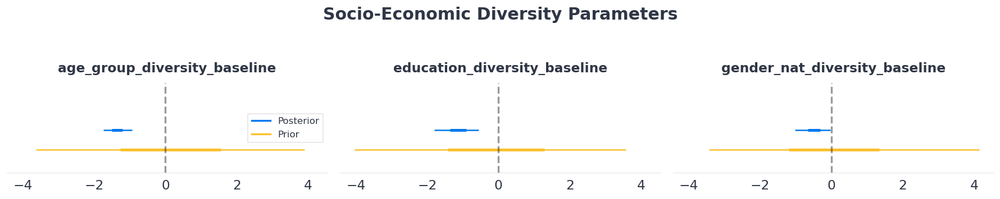

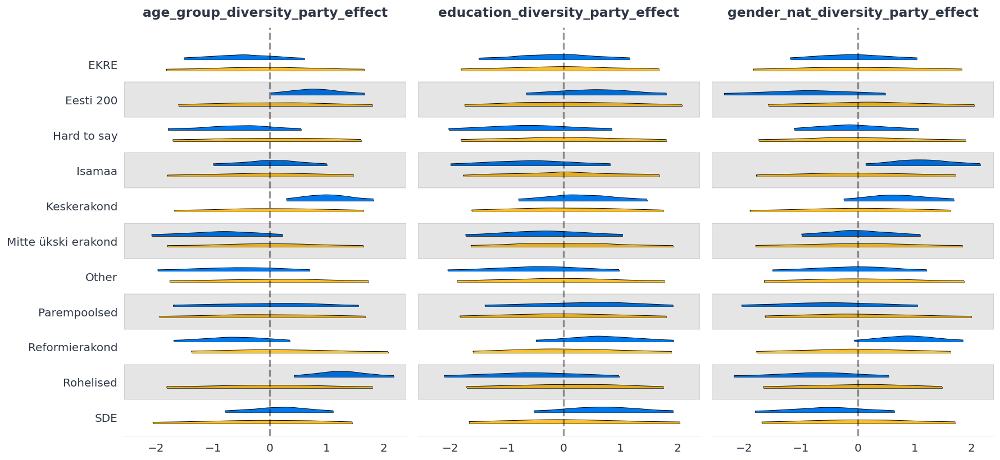

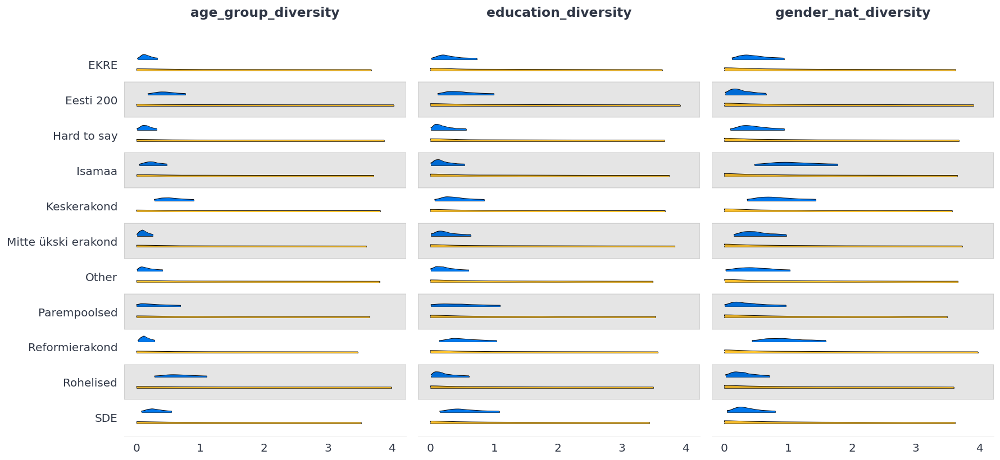

In [33]:
fig, axes = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(15, 3))
for i, var in enumerate(var_baseline):
    az.plot_forest(
        [idata_agg_ans, idata_agg_ans.prior],
        var_names=var,
        combined=True,
        ax=axes[i],
        legend=False,
    )
    axes[i].axvline(color="k", ls="--", alpha=0.4, lw=2)
    axes[i].set_title(var, fontsize=14)
    axes[i].set_yticklabels([])
    handles = [
        mlines.Line2D([], [], color="C0", lw=2, label="Posterior"),
        mlines.Line2D([], [], color="C1", lw=2, label="Prior"),
    ]
    axes[0].legend(handles=handles, frameon=True, fontsize=10)
fig.suptitle("Socio-Economic Diversity Parameters\n", fontsize=18)
fig.tight_layout()

fig, axes = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(15, 7))
for i, var in enumerate(var_party_effect):
    az.plot_forest(
        [idata_agg_ans, idata_agg_ans.prior],
        var_names=var,
        combined=True,
        ax=axes[i],
        kind="ridgeplot",
        ridgeplot_overlap=1,
    )
    axes[i].axvline(color="k", ls="--", alpha=0.4, lw=2)
    axes[i].set_title(var, fontsize=14)
    axes[i].set_yticklabels(AGG_ANS_NAIVE_COORDS["immutable"]["party"][::-1])
    axes[i].legend([])
fig.tight_layout()

fig, axes = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(15, 7))
for i, var in enumerate(var_diversity):
    az.plot_forest(
        [idata_agg_ans, idata_agg_ans.prior],
        var_names=var,
        combined=True,
        ax=axes[i],
        kind="ridgeplot",
        ridgeplot_overlap=1,
    )
    axes[i].set_title(var, fontsize=14)
    axes[i].set_yticklabels(AGG_ANS_NAIVE_COORDS["immutable"]["party"][::-1])
    axes[i].legend([])
fig.tight_layout()
plt.show()

### Notes
* **Well-calibrated priors**- the posteriors are always contained in the priors, which is usually what you want.
* a sign that the **priors are too constraining**- when some posteriors (for baseline or party_effect) ended up completely outside of their prior range.
* When the **prior is too strong**- the diversity parameter isn't able to move away from the prior as much as the data warrant it, leading to an underestimation of the diversities.

# Interaction and Main Effects

## Interaction only model
* No main effects
* interaction only- treat each (gender, nationality) pair as a single component
    * the features are treated as dependent (not independent- different axes)
* `1 + gender:nat` in bambi

In [34]:
# interaction only model
with pm.Model(
    coords=AGG_ANS_NAIVE_COORDS["immutable"], 
    coords_mutable=AGG_ANS_NAIVE_COORDS["mutable"], 
    check_bounds=False
) as agg_ans_int_model:
    
    #### DATA ####
    # * hierarchical horizontal  components
    gender_id = pm.MutableData("gender_id", gender_idx, dims="obs_idx")
    nationality_id = pm.MutableData("nationality_id", nationality_idx, dims="obs_idx")
    # * likelihood model components
    N = pm.MutableData("N", observed_aggregated_answers["N"].to_numpy(), dims="obs_idx")
    observed = pm.MutableData(
        "observed",
        observed_aggregated_answers[AGG_ANS_NAIVE_COORDS["immutable"]["party"]].to_numpy(),
        dims=("obs_idx", "party"),
    )
    #### DATA ####
    
    # BASELINE- latent popularity for each party
    baseline_sd = pm.Gamma("baseline_sd", 2, 2)
    # a good weakly regularizing prior for standard deviations (better than HalfNormal(0.5))
    baseline = pm.ZeroSumNormal("baseline", sigma=baseline_sd, dims="party")

    #### INTERACTION COMPONENT ####
    # *  treat (gender, nationality) pair as a single component 
    β_gender_nat_raw = (
        pm.ZeroSumNormal("β_gender_nat_raw", shape=(n_gender * n_nat, n_party), n_zerosum_axes=2)
        .reshape((n_gender, n_nat, n_party))
    )
    β_gender_nat_scale = create_sigma("gender_nat_diversity", regress_sigma=True) 

    β_gender_nat =  pm.Deterministic(
        "β_gender_nat", β_gender_nat_raw * β_gender_nat_scale, dims=("gender", "nationality", "party")
    )
    
   # Regression components
    η = (
        baseline + β_gender_nat[gender_id, nationality_id]
    )
    
    # make sure array of responses probs close to 1
    assert np.allclose(
        pm.math.softmax(η, axis=-1).eval().sum(-1), np.ones(age_group_id.eval().shape)
    )
    probs = pm.math.softmax(η, axis=-1)
    # Multinomial Likelihood
    _  = pm.Multinomial("y", n=N, p=probs,  observed=observed, dims=("obs_idx", "party"))
    
    idata_agg_ans_int = pm.sample(random_seed=rng, target_accept=0.85)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline_sd, baseline, β_gender_nat_raw, gender_nat_diversity_baseline, gender_nat_diversity_party_effect]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 408 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


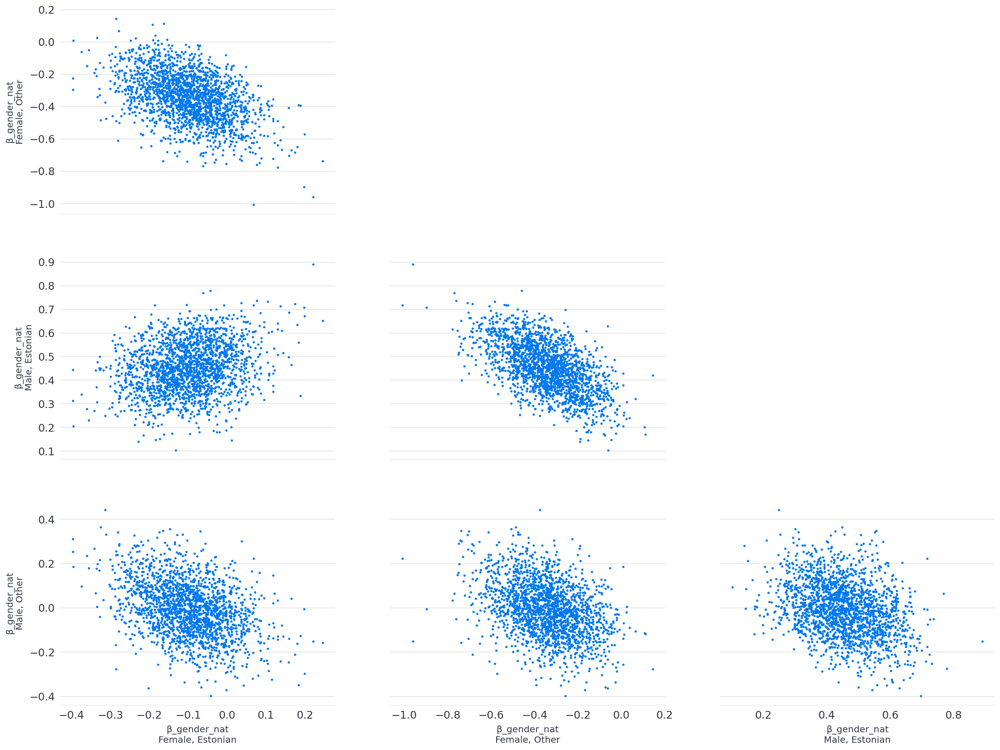

In [35]:
posterior_ekre = idata_agg_ans_int.posterior.sel(party="EKRE")
az.plot_pair(posterior_ekre[["β_gender_nat"]]);

### Notes
* The pair plot looks good

## Interaction + Main Effects
* add main effects + interaction term
    * now the faetures are treated as independent (two axes) because of the main effects
* in bambi `1 + gender + nat + gender:nat`

In [36]:
# main effects + interactions of gender and nationality
with pm.Model(
    coords=AGG_ANS_NAIVE_COORDS["immutable"], 
    coords_mutable=AGG_ANS_NAIVE_COORDS["mutable"], 
    check_bounds=False
) as agg_ans_int_main_model:
    
    #### DATA ####
    # * hierarchical horizontal  components
    gender_id = pm.MutableData("gender_id", gender_idx, dims="obs_idx")
    nationality_id = pm.MutableData("nationality_id", nationality_idx, dims="obs_idx")
    # * likelihood model components
    N = pm.MutableData("N", observed_aggregated_answers["N"].to_numpy(), dims="obs_idx")
    observed = pm.MutableData(
        "observed",
        observed_aggregated_answers[AGG_ANS_NAIVE_COORDS["immutable"]["party"]].to_numpy(),
        dims=("obs_idx", "party"),
    )
    #### DATA ####
    
    # BASELINE- latent popularity for each party
    baseline_sd = pm.Gamma("baseline_sd", 2, 2)
    # a good weakly regularizing prior for standard deviations (better than HalfNormal(0.5))
    baseline = pm.ZeroSumNormal("baseline", sigma=baseline_sd, dims="party")

    #### INTERACTION COMPONENT ####
    β_gender = hierarchical_zsn(
        name="β_gender", dims="gender", n_zerosum_axes=2, regress_sigma=True
    )
    
    β_nat = hierarchical_zsn(
        name="β_nat", dims="nationality", n_zerosum_axes=2, regress_sigma=True
    )
    
    # treat each component (gender, nationality) independently (instead of as a pair)
    β_gender_nat = hierarchical_zsn(
        "β_gender_nat", ["gender", "nationality"], n_zerosum_axes=3, regress_sigma=True
    )
    
   # Regression components
    η = (
        baseline + β_gender[gender_id] + β_nat[nationality_id] + β_gender_nat[gender_id, nationality_id]
    )
    
    # make sure array of responses probs close to 1
    assert np.allclose(
        pm.math.softmax(η, axis=-1).eval().sum(-1), np.ones(age_group_id.eval().shape)
    )
    probs = pm.math.softmax(η, axis=-1)
    # Multinomial Likelihood
    _  = pm.Multinomial("y", n=N, p=probs,  observed=observed, dims=("obs_idx", "party"))
    
    idata_agg_ans_int_main = pm.sample(random_seed=rng, target_accept=0.85)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline_sd, baseline, β_gender_raw, gender_diversity_baseline, gender_diversity_party_effect, β_nat_raw, nat_diversity_baseline, nat_diversity_party_effect, β_gender_nat_raw, gender_nat_diversity_baseline, gender_nat_diversity_party_effect]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 615 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


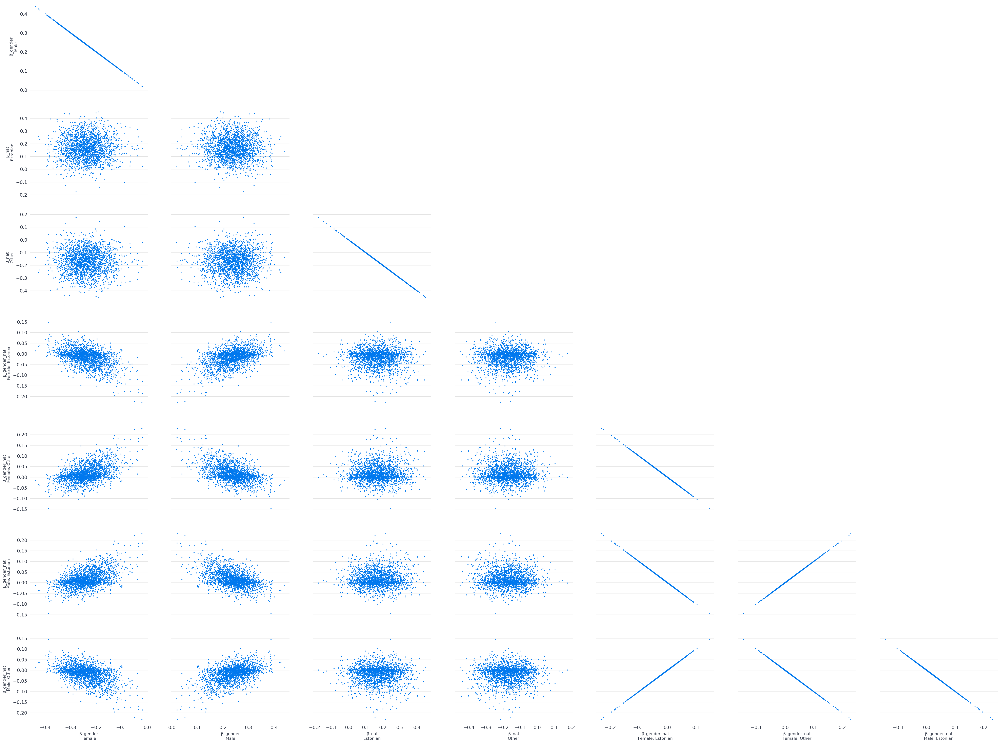

In [37]:
posterior_ekre = idata_agg_ans_int_main.posterior.sel(party="EKRE")
az.plot_pair(posterior_ekre[["β_gender", "β_nat", "β_gender_nat"]])
plt.show()

### Notes
* there is a perfect correlation between the interaction parameters.
    * sampling is slower and has many divergences
* we have 4 combinations of (gender, nationality) pairs (i.e., 4 DoF (independent coefficients)):
    * baseline is one
    * gender main effect is one (using pivoting/ZeroSumNormal)
    * nationality main effect is one (using pivoting/ZeroSumNormal)
    * only one independent parameter for the interaction
        * there's a single parameter value, and once is inferred, all the others are a function of that one\
        (and in this case, they are exactly the same).
        * **possible solution**- strengthen the priors

In [38]:
β_gender_nat.eval()[..., 0].sum(0)

array([0., 0.])

In [39]:
β_gender_nat.eval()[..., 0].sum(1)

array([0., 0.])

In [40]:
β_gender_nat.eval()[..., 0]

array([[-1.35841828,  1.35841828],
       [ 1.35841828, -1.35841828]])

The **model is _not_ over-parametrized**, thanks to our ZSN constraint. However, that means the model only has **one independent parameter for the interaction**, which makes sampling inefficient and prone to divergences (unless we strengthen the priors- e.g., use exponential function). 

In this case, **the first model is more sensible**, as it:
- Samples faster and more efficiently.
- Has fewer perfectly correlated coefficients.
- Implements partial-pooling once on four groups instead of three times on 2-level groups and their interaction (when we partially pool the two genders, then the two nationalities, then the interaction separately).

**This issue should disappear as the number of levels of our categorical predictors increases**.

### Main Effect + Interaction - Second Try
* main effect + interaction on features with __many categorical values__
    * we will have enough DoF to get a proper answer for the interaction term
* in babmi `1 + age + education + gender:education`

In [41]:
age_groups.size, educations.size

(7, 3)

In [42]:
# main effect for age_group, education + interactions of age_group, education
with pm.Model(
    coords=AGG_ANS_NAIVE_COORDS["immutable"], 
    coords_mutable=AGG_ANS_NAIVE_COORDS["mutable"], 
    check_bounds=False
) as agg_ans_int_single_main_model3:
    
    #### DATA ####
    # * hierarchical horizontal  components
    age_group_id = pm.MutableData("age_group_id", age_group_idx, dims="obs_idx")
    education_id = pm.MutableData("education_id", education_idx, dims="obs_idx")
    # * likelihood model components
    N = pm.MutableData("N", observed_aggregated_answers["N"].to_numpy(), dims="obs_idx")
    observed = pm.MutableData(
        "observed",
        observed_aggregated_answers[AGG_ANS_NAIVE_COORDS["immutable"]["party"]].to_numpy(),
        dims=("obs_idx", "party"),
    )
    #### DATA ####
    
    # BASELINE- latent popularity for each party
    baseline_sd = pm.Gamma("baseline_sd", 2, 2)
    # a good weakly regularizing prior for standard deviations (better than HalfNormal(0.5))
    baseline = pm.ZeroSumNormal("baseline", sigma=baseline_sd, dims="party")

    #### INTERACTION COMPONENT ####
    β_gender = hierarchical_zsn(
        name="β_gender", dims="gender", n_zerosum_axes=2, regress_sigma=True
    )
    
    β_education = hierarchical_zsn(
        name="β_education", dims="education", n_zerosum_axes=2, regress_sigma=True
    )
    
    # treat each component (gender, nationality) independently (instead of as a pair)
    β_age_edu = hierarchical_zsn(
        "β_age_edu", ["age_group", "education"], n_zerosum_axes=3, regress_sigma=True
    )
    
   # Regression components
    η = (
        baseline + β_gender[gender_id] + β_education[education_id] + β_age_edu[age_group_id, education_id]
    )
    
    # make sure array of responses probs close to 1
    assert np.allclose(
        pm.math.softmax(η, axis=-1).eval().sum(-1), np.ones(age_group_id.eval().shape)
    )
    probs = pm.math.softmax(η, axis=-1)
    # Multinomial Likelihood
    _  = pm.Multinomial("y", n=N, p=probs,  observed=observed, dims=("obs_idx", "party"))
    
    idata_agg_ans_int_main3 = pm.sample(random_seed=rng, target_accept=0.85)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [baseline_sd, baseline, β_gender_raw, gender_diversity_baseline, gender_diversity_party_effect, β_education_raw, education_diversity_baseline, education_diversity_party_effect, β_age_edu_raw, age_edu_diversity_baseline, age_edu_diversity_party_effect]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 304 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


/home/studio-lab-user/.conda/envs/ib_advanced_regression/lib/python3.11/site-packages/arviz/plots/backends/matplotlib/pairplot.py:232: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


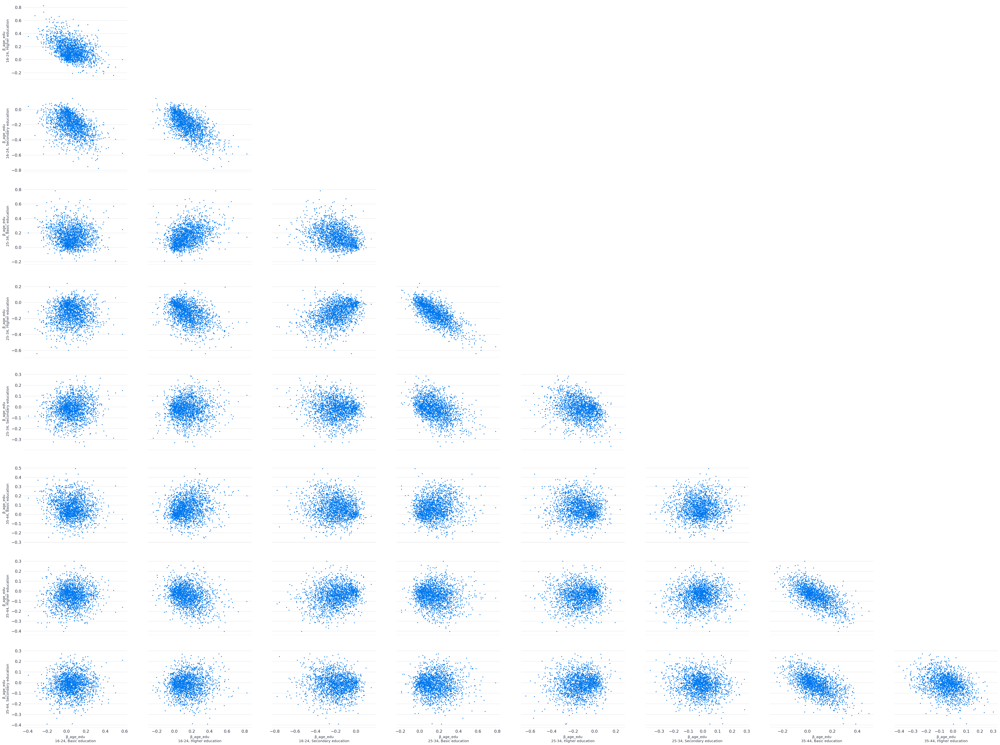

In [43]:
posterior_ekre = idata_agg_ans_int_main3.posterior.sel(party="EKRE")
az.plot_pair(posterior_ekre["β_age_edu"])
plt.show()

* We still see some correlations here and there, but nothing comparable, and that's why sampling was much better.
* convergence issues should decrease as the number of levels increases.